#CNN-Image classification

In [11]:
import numpy as np
import cv2
from os import listdir
from os.path import isfile, join           
from tqdm import tqdm
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten , Conv2D, MaxPooling2D , GlobalAveragePooling2D , AveragePooling2D
import matplotlib.pyplot as plt
import random

In [12]:
width = 128
num_classes = 5
trainpath = 'D:/Durian/train/'
testpath = 'D:/Durian/test/'
trainImg = [trainpath+f for f in listdir(trainpath)]
testImg = [testpath+f for f in listdir(testpath)]

In [13]:
def fill(img, h, w):
    img = cv2.resize(img, (h, w), cv2.INTER_CUBIC)
    return img

def horizontal_shift(img, ratio=0.0):
    if ratio > 1 or ratio < 0:
        print('Value should be less than 1 and greater than 0')
        return img
    ratio = random.uniform(-ratio, ratio)
    h, w = img.shape[:2]
    to_shift = w*ratio
    if ratio > 0:
        img = img[:, :int(w-to_shift), :]
    if ratio < 0:
        img = img[:, int(-1*to_shift):, :]
    img = fill(img, h, w)
    return img

def vertical_shift(img, ratio=0.0):
    if ratio > 1 or ratio < 0:
        return img
    ratio = random.uniform(-ratio, ratio)
    h, w = img.shape[:2]
    to_shift = h*ratio
    if ratio > 0:
        img = img[:int(h-to_shift), :, :]
    if ratio < 0:
        img = img[int(-1*to_shift):, :, :]
    img = fill(img, h, w)
    return img

def brightness(img, low, high):
    value = random.uniform(low, high)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype = np.float64)
    hsv[:,:,1] = hsv[:,:,1]*value
    hsv[:,:,1][hsv[:,:,1]>255]  = 255
    hsv[:,:,2] = hsv[:,:,2]*value 
    hsv[:,:,2][hsv[:,:,2]>255]  = 255
    hsv = np.array(hsv, dtype = np.uint8)
    img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return img

def channel_shift(img, value):
    value = int(random.uniform(-value, value))
    img = img + value
    img[:,:,:][img[:,:,:]>255]  = 255
    img[:,:,:][img[:,:,:]<0]  = 0
    img = img.astype(np.uint8)
    return img

def horizontal_flip(img, flag):
    if flag:
        return cv2.flip(img, 1)
    else:
        return img

def vertical_flip(img, flag):
    if flag:
        return cv2.flip(img, 0)
    else:
        return img

def rotation(img, angle):
    angle = int(random.uniform(-angle, angle))
    h, w = img.shape[:2]
    M = cv2.getRotationMatrix2D((int(w/2), int(h/2)), angle, 1)
    img = cv2.warpAffine(img, M, (w, h))
    return img

def original (img):
    return img

In [14]:
def img2data(path):
    rawImgs = []
    labels = []
    for label in listdir(path) :
        # print(label)
        for item in tqdm(listdir(path +"/"+ label)) :
            # print(path + "/" + label + "/" + item)
            img = cv2.imread(path + "/" + label + "/" + item  , cv2.COLOR_BGR2RGB)
            augment = [original(img)]
            for augment_function in augment :
                img = augment_function
                img = cv2.resize(img ,(width,width))
                rawImgs.append(img)

                if label == "agal_spot" :
                    labels.append([1,0,0,0,0])
                elif label == "Anthracnose" :
                    labels.append([0,1,0,0,0])
                elif label == "left_blinght" :
                    labels.append([0,0,1,0,0])
                elif label == "normal" :
                    labels.append([0,0,0,1,0])
                elif label == "sooty_mold" :
                    labels.append([0,0,0,0,1])
        # print("rawImgs :" , rawImgs)
        # print("labels :" , labels)
    return rawImgs, labels

In [15]:
def img2data_augment(path):
    rawImgs = []
    labels = []
    for label in listdir(path) :
        # print(label)
        for item in tqdm(listdir(path +"/"+ label)) :
            # print(path + "/" + label + "/" + item)
            img = cv2.imread(path + "/" + label + "/" + item  , cv2.COLOR_BGR2RGB)
            augment = [ 
                        original(img) ,
                        # horizontal_shift(img , 0.7) , 
                        # vertical_shift(img , 0.7) , 
                        # brightness(img, 0.5, 3) , 
                        # channel_shift(img, 60)  , 
                        horizontal_flip(img, True) , 
                        vertical_flip(img, True) , 
                        rotation(img, 30) , 
                        rotation(img, 60) ,
                        rotation(img, 90),
                        rotation(img, 120)
                      ]
            for augment_function in augment :
                img = augment_function
                img = cv2.resize(img ,(width,width))
                rawImgs.append(img)

                if label == "agal_spot" :
                    labels.append([1,0,0,0,0])
                elif label == "Anthracnose" :
                    labels.append([0,1,0,0,0])
                elif label == "left_blinght" :
                    labels.append([0,0,1,0,0])
                elif label == "normal" :
                    labels.append([0,0,0,1,0])
                elif label == "sooty_mold" :
                    labels.append([0,0,0,0,1])
        # print("rawImgs :" , rawImgs)
        # print("labels :" , labels)
    return rawImgs, labels

In [16]:
x_test, y_test = img2data("D:/Durian/test")

100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  6.18it/s]


In [17]:
x_train, y_train = img2data_augment("D:/Durian/train")

100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:03<00:00,  3.23it/s]


In [18]:
x_train = np.array(x_train)
y_train = np.array(y_train)
x_test = np.array(x_test)
y_test = np.array(y_test)
x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255.
x_test /= 255.

In [19]:
x_train.shape,y_train.shape,x_test.shape, y_test.shape

((9394, 128, 128, 3), (9394, 5), (190, 128, 128, 3), (190, 5))

In [20]:
# files_name = ["x_test" , "y_test"]
files_name = ["x_train" , "y_train" , "x_test" , "y_test"]
files = [x_train , y_train ,x_test , y_test]
for i in range(4) :
    np.save(files_name[i] , files[i] )

In [21]:
x_train = np.load("x_train.npy")
y_train = np.load("y_train.npy")
x_test = np.load("x_test.npy")
y_test = np.load("y_test.npy")

[1 0 0 0 0]


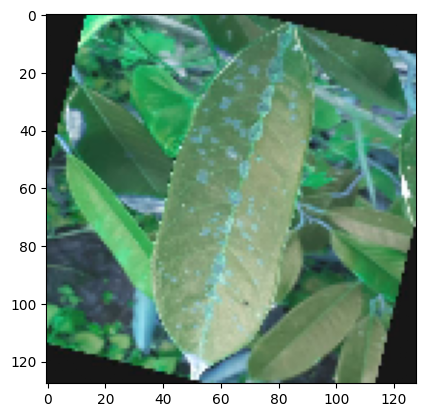

In [22]:
print(y_train[1])
plt.imshow(x_train[1])

[1 0 0 0 0]


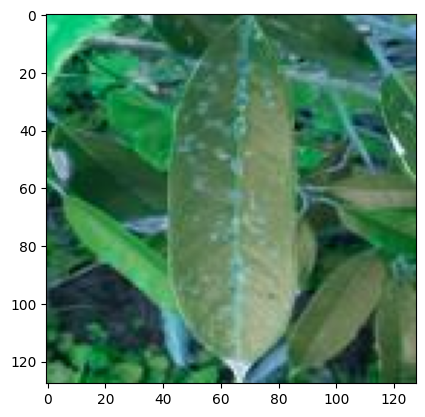

In [23]:
print(y_test[2])
plt.imshow(x_test[2])

In [24]:
base_model = tf.keras.applications.EfficientNetB0(input_shape=(128,128,3),
                                                   include_top=False,
                                                   weights='imagenet')
# base_model.trainable = False

num_classes = 5

model = Sequential([
        base_model,
        Conv2D(128, 3, activation='relu'),
        Conv2D(128,3,activation="relu",padding="same"),
        # MaxPooling2D(),
        Conv2D(256,3,activation="relu",padding="same"),
        Conv2D(256,3,activation="relu",padding="same"),
        Flatten(),
        Dense(32),
        Dropout(0.5),
        Dense(64),
        Dropout(0.5),
        Dense(128),
        Dropout(0.5),
        Dense(64),
        Dropout(0.5),
        Dense(num_classes, activation='softmax')
    ])

In [10]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
base_model = InceptionV3(input_shape = (128, 128, 3), include_top = False, weights = 'imagenet')

87910968/87910968 [==============================] - 389s 4us/step


In [25]:
# Requriment Model

base_model = tf.keras.applications.vgg16.VGG16(input_shape=(128,128,3),
                                                   include_top=False,
                                                   weights='imagenet')
base_model.trainable = False

num_classes = 5

model = Sequential([
        base_model,
        # Conv2D(128, 3, activation='relu'),
        # Conv2D(128,3,activation="relu",padding="same"),
        # # MaxPooling2D(),
        # Conv2D(256,3,activation="relu",padding="same"),
        # Conv2D(256,3,activation="relu",padding="same"),
        Flatten(),
        Dense(32),
        Dropout(0.5),
        Dense(64),
        Dropout(0.5),
        Dense(128),
        Dropout(0.5),
        Dense(64),
        Dropout(0.5),
        Dense(num_classes, activation='softmax')
    ])

In [15]:
def LeNet5(input_shape, nb_classes):
        model.add(Conv2D(6, kernel_size=(5, 5), strides=(1, 1), activation='tanh', input_shape=input_shape, padding="same"))
        model.add(AveragePooling2D(pool_size=(2, 2), strides=(1, 1), padding='valid'))
        model.add(Conv2D(16, kernel_size=(5, 5), strides=(1, 1), activation='tanh', padding='valid'))
        model.add(AveragePooling2D(pool_size=(2, 2), strides=(2, 2), padding='valid'))
        model.add(Conv2D(120, kernel_size=(5, 5), strides=(1, 1), activation='tanh', padding='valid'))
        model.add(Flatten())
        model.add(Dense(84, activation='tanh'))
        model.add(Dense(nb_classes, activation='softmax'))

In [16]:
model = Sequential()
# LeNet5((128,128,3),5)

In [15]:
model = Sequential()
#Layer 1
#Conv Layer 1
model.add(Conv2D(filters = 6, 
                 kernel_size = 5, 
                 strides = 1, 
                 activation = 'relu', 
                 input_shape = (128,128,3)))
#Pooling layer 1
model.add(MaxPooling2D(pool_size = 2, strides = 2))
#Layer 2
#Conv Layer 2
model.add(Conv2D(filters = 16, 
                 kernel_size = 5,
                 strides = 1,
                 activation = 'relu',
                 input_shape = (14,14,6)))
#Pooling Layer 2
model.add(MaxPooling2D(pool_size = 2, strides = 2))
#Flatten
model.add(Flatten())
#Layer 3
#Fully connected layer 1
model.add(Dense(units = 120, activation = 'relu'))
#Layer 4
#Fully connected layer 2
model.add(Dense(units = 84, activation = 'relu'))
#Layer 5
#Output Layer
model.add(Dense(units = 10, activation = 'softmax'))

In [26]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten_1 (Flatten)         (None, 8192)              0         
                                                                 
 dense_5 (Dense)             (None, 32)                262176    
                                                                 
 dropout_4 (Dropout)         (None, 32)                0         
                                                                 
 dense_6 (Dense)             (None, 64)                2112      
                                                                 
 dropout_5 (Dropout)         (None, 64)                0         
                                                                 
 dense_7 (Dense)             (None, 128)              

In [27]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              loss='categorical_crossentropy', 
              metrics= ['accuracy'])

In [28]:
batch_size = 32
epochs = 5

In [29]:
history = model.fit(x_train, y_train ,batch_size=batch_size, epochs=epochs ,validation_data=(x_test, y_test))

Epoch 1/5
294/294 [==============================] - 53s 158ms/step - loss: 2.0280 - accuracy: 0.5416 - val_loss: 0.8796 - val_accuracy: 0.7105
Epoch 2/5
294/294 [==============================] - 42s 143ms/step - loss: 0.9155 - accuracy: 0.7117 - val_loss: 0.6557 - val_accuracy: 0.7632
Epoch 3/5
294/294 [==============================] - 43s 145ms/step - loss: 0.6518 - accuracy: 0.7782 - val_loss: 0.6500 - val_accuracy: 0.7895
Epoch 4/5
294/294 [==============================] - 43s 146ms/step - loss: 0.5340 - accuracy: 0.8131 - val_loss: 0.6303 - val_accuracy: 0.7632
Epoch 5/5
294/294 [==============================] - 43s 147ms/step - loss: 0.4385 - accuracy: 0.8484 - val_loss: 0.6036 - val_accuracy: 0.8211


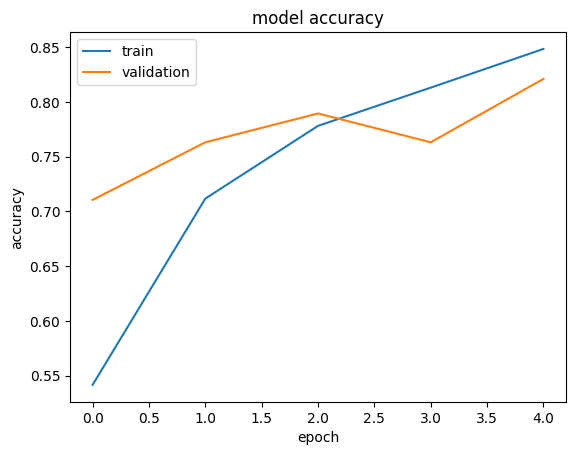

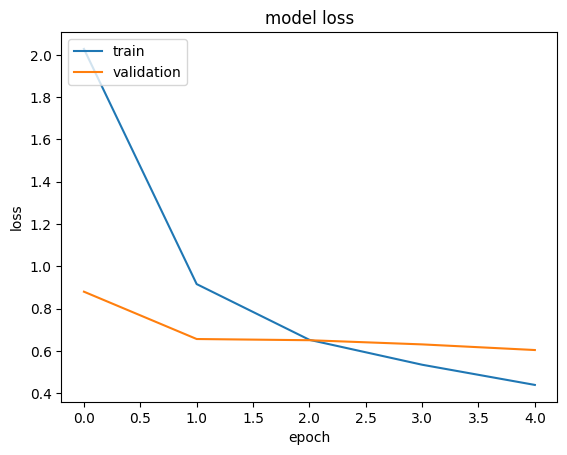

In [30]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()
# "Loss"
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 1s 922ms/step
file : D:/Durian/test/agal_spot\0F0BF881-DE00-4A4E-8BED-3DA34A2BF50F.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.2962248  0.17659101 0.31107065 0.16514955 0.05096401]]
predict : left_blinght


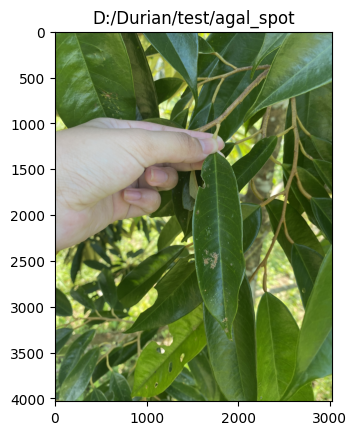

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\1AA41CCC-6D32-4102-BC36-25099AA5B9E1.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.7304736  0.12737362 0.11370213 0.01389791 0.01455278]]
predict : agal_spot


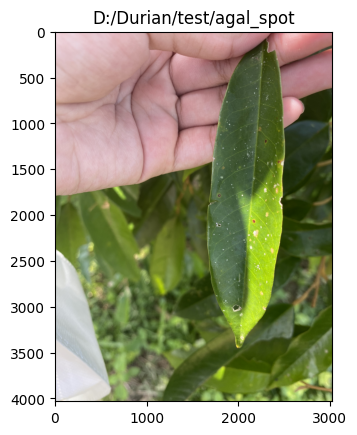

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot001_jpg.rf.b7d92def8c3b4a3ba74e19e117fb710b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.8167988  0.0353696  0.02166254 0.11057256 0.01559643]]
predict : agal_spot


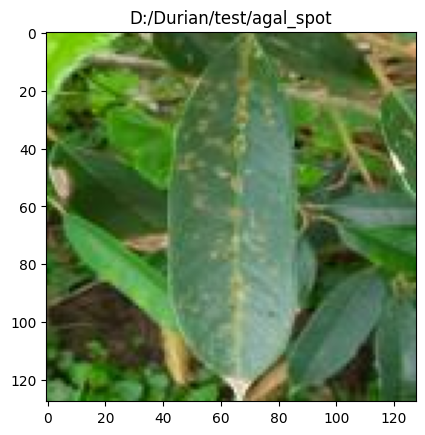

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot003_jpg.rf.efdf9fda3a32b5766fc1af4e4ddeb51d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[8.7141204e-01 4.0130352e-04 1.1162842e-01 1.3428500e-02 3.1297274e-03]]
predict : agal_spot


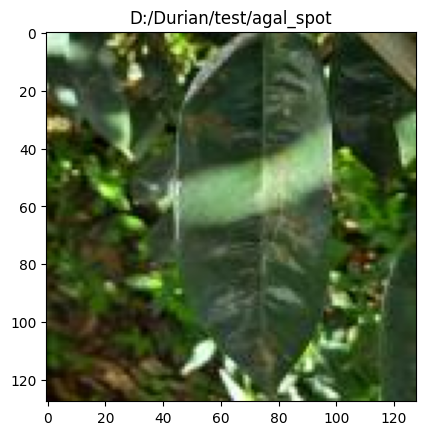

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot008_jpg.rf.cc40c83060502610cd7f329e6e0ee57e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.1067932  0.856563   0.01812934 0.00856607 0.00994835]]
predict : Anthracnose


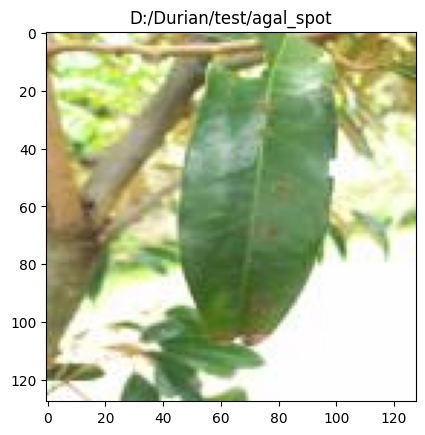

1/1 [==============================] - 0s 24ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot009_jpg.rf.b3a5312b11dae8c5d850953f0ec7c4cc.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.60857886 0.3550839  0.00344251 0.02344602 0.00944865]]
predict : agal_spot


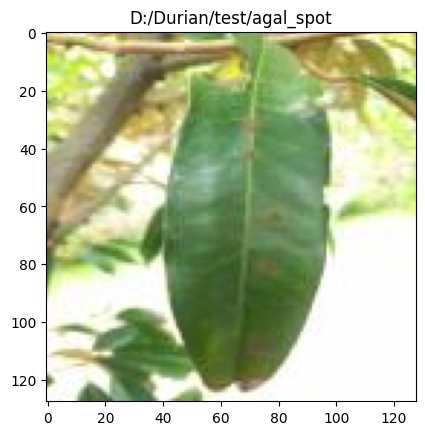

1/1 [==============================] - 0s 22ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot010_jpg.rf.8abf23e34d36b77879b2c5ac271d95c8.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.49471763 0.30874348 0.13488121 0.03613484 0.02552285]]
predict : agal_spot


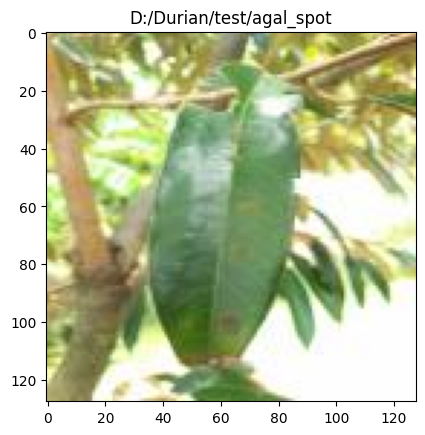

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot013_jpg.rf.8f57fe755639f1ec1053168404196f9e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.940858   0.0325879  0.0030651  0.01843993 0.00504908]]
predict : agal_spot


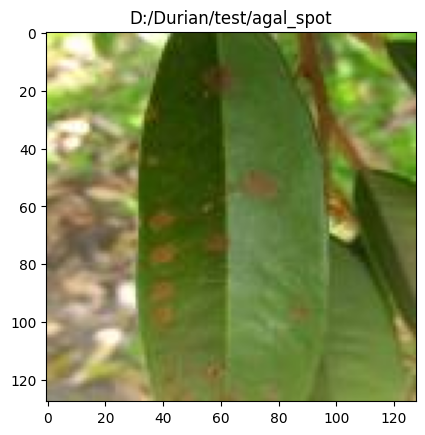

1/1 [==============================] - 0s 26ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot014_jpg.rf.d88ed03ef3f026a7da21779da4f3edd3.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.8778101  0.09371629 0.02143737 0.00275597 0.00428022]]
predict : agal_spot


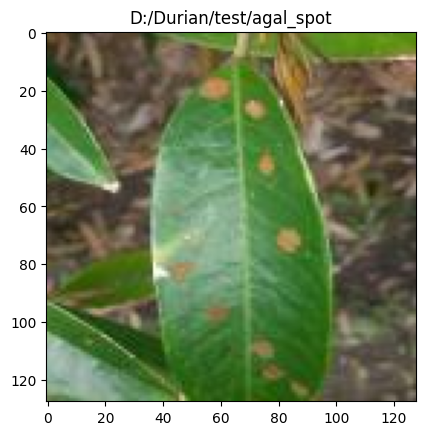

1/1 [==============================] - 0s 23ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot015_jpg.rf.d4a9047f7a1186813f48613b3ff7e866.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.64721316 0.14027551 0.17443544 0.01990055 0.01817537]]
predict : agal_spot


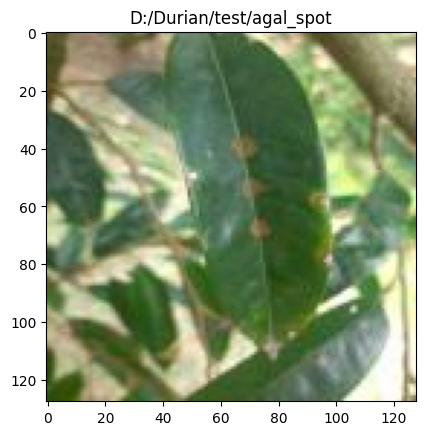

1/1 [==============================] - 0s 17ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot018_jpg.rf.11a2ab4c0b94ae462652dce1000ce094.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.80391586 0.15119718 0.00966529 0.02442214 0.01079952]]
predict : agal_spot


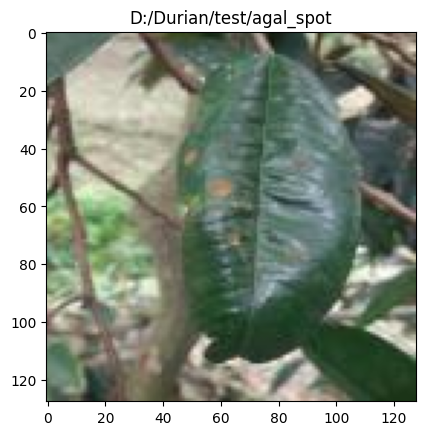

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot024_jpg.rf.9aaf4e8614887954e4af55bab8f51b7a.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.74020886 0.1521662  0.08172341 0.01257574 0.01332582]]
predict : agal_spot


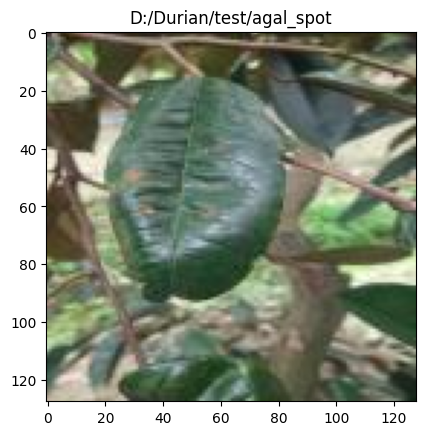

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot033_jpg.rf.b91a6acc1685d5bce8ebe7cd65703f67.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.9393189  0.02457937 0.02765765 0.00434473 0.00409935]]
predict : agal_spot


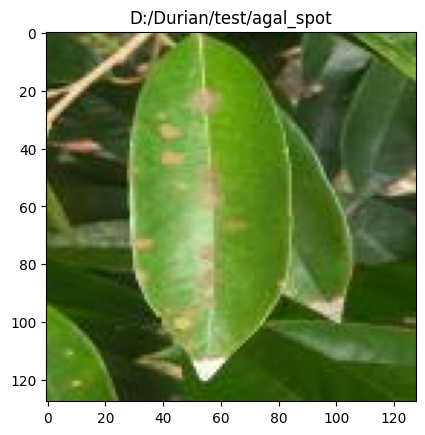

1/1 [==============================] - 0s 22ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot039_jpg.rf.1672c24ef49cd9f05162d47a10fa8be0.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.3689344  0.48702776 0.0300586  0.08521704 0.02876212]]
predict : Anthracnose


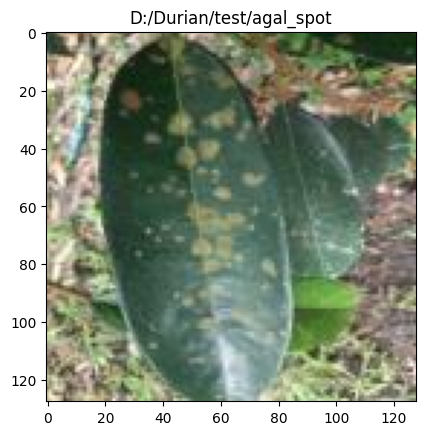

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot041_jpg.rf.fc7f564feb1e6c2f66b92c790ab08048.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.71684337 0.2469051  0.02730153 0.00260579 0.00634423]]
predict : agal_spot


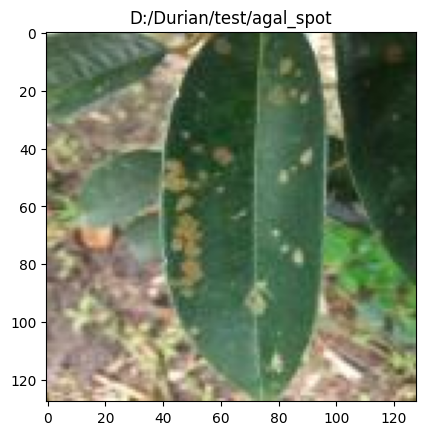

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot042_jpg.rf.0939352f893042e2f798054113b2a1c8.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.7624266  0.07688876 0.11756912 0.0247581  0.01835739]]
predict : agal_spot


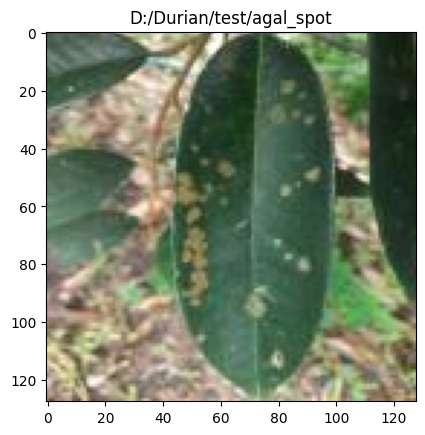

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot044_jpg.rf.9d7691d5f04a75e7edb81073a1a71f58.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.95224994 0.02408632 0.00398904 0.01576602 0.00390877]]
predict : agal_spot


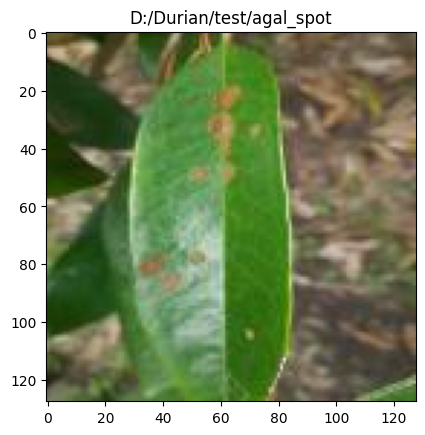

1/1 [==============================] - 0s 28ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot050_jpg.rf.ccc242d9eaf055732271e8eac266c3fd.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[9.8730415e-01 8.8823950e-03 3.0600601e-03 2.1456121e-04 5.3886132e-04]]
predict : agal_spot


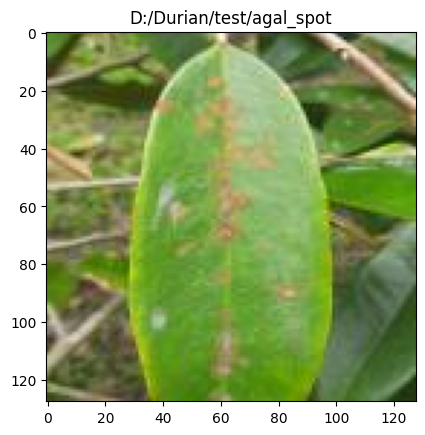

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot058_jpg.rf.1f130b579fd86410de86cfedc997584a.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.97843206 0.01189292 0.00267399 0.00499725 0.00200388]]
predict : agal_spot


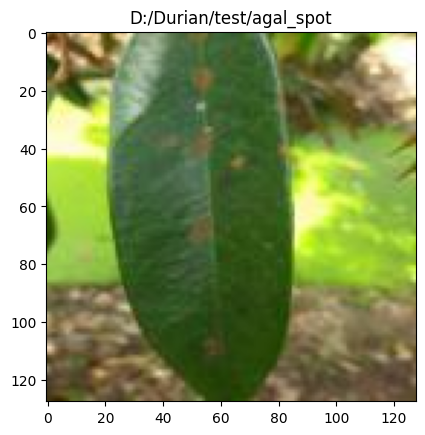

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot060_jpg.rf.f05e5693423fab52e18c863627cf84f9.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.85602087 0.11960334 0.00153969 0.01783364 0.00500245]]
predict : agal_spot


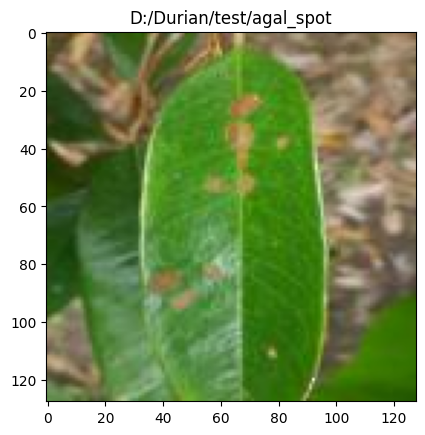

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot061_jpg.rf.08f1909afb38963fa150be4beb0fa0f2.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[9.9216312e-01 5.4928870e-03 2.8358807e-04 1.4410825e-03 6.1927043e-04]]
predict : agal_spot


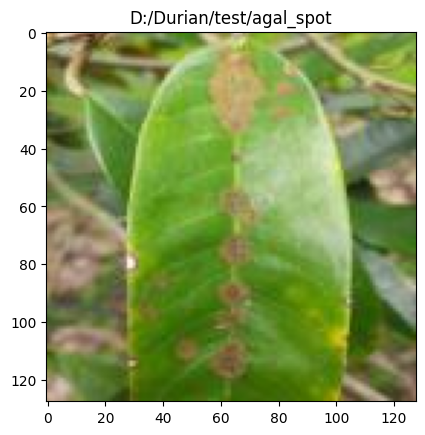

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot070_jpg.rf.b55594fc74bc1c56e2323c88998ec547.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[8.6179513e-01 3.4621701e-02 1.0077823e-01 4.3168271e-04 2.3733077e-03]]
predict : agal_spot


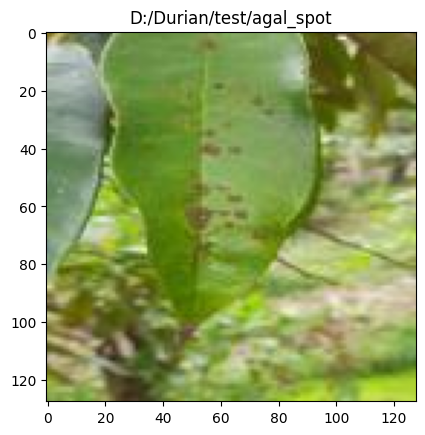

1/1 [==============================] - 0s 24ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot074_jpg.rf.70bae0b699420a4587ddd493d1522aed.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.76696056 0.20415626 0.01380688 0.00743915 0.00763711]]
predict : agal_spot


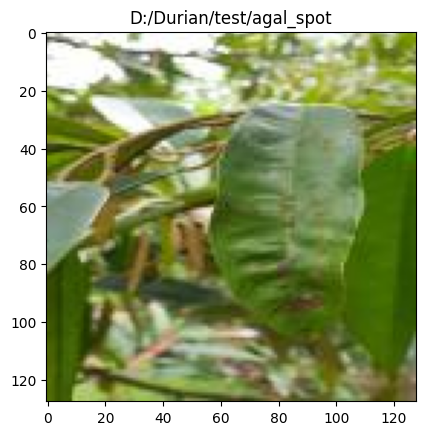

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot075_jpg.rf.0b3c784bc5023206459320e4a4e8ac02.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.9644232  0.02894611 0.00257958 0.00209981 0.0019513 ]]
predict : agal_spot


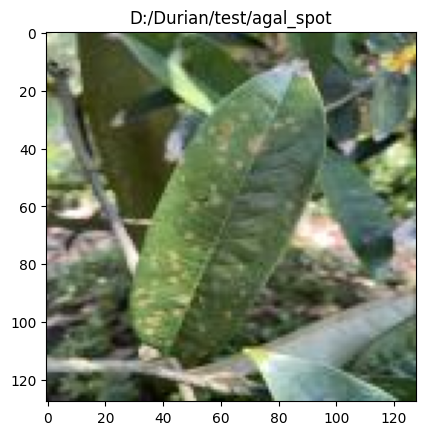

1/1 [==============================] - 0s 25ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot076_jpg.rf.558505c4360f8a58bdc69087ac507493.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.95084095 0.03408735 0.00777703 0.00387936 0.00341536]]
predict : agal_spot


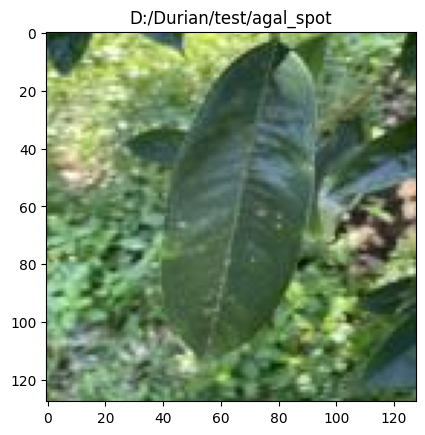

1/1 [==============================] - 0s 22ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot078_jpg.rf.65c5fd726b7acf6d4caa03a2736293d8.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.31312874 0.5730374  0.07539809 0.0194126  0.01902314]]
predict : Anthracnose


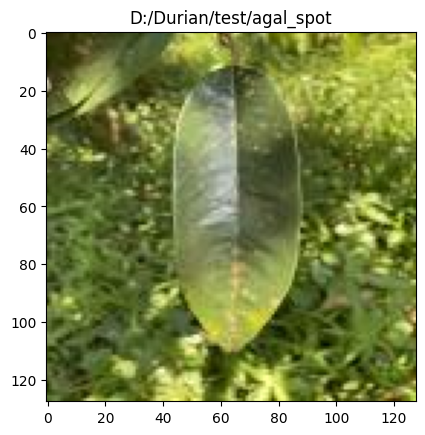

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot081_jpg.rf.8b02ff9ea5e6858fec991f4111885ba9.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.80547315 0.18767378 0.00104184 0.00306677 0.00274451]]
predict : agal_spot


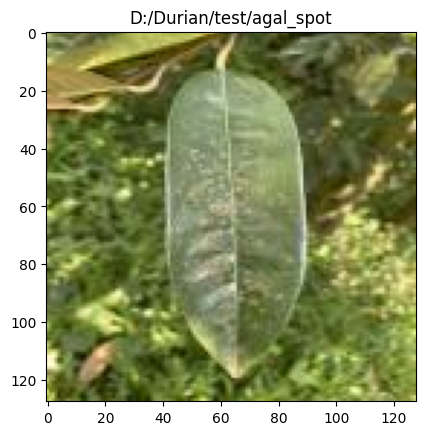

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot084_jpg.rf.d3ae9cd08cb6c786c01910539e9b879d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.7750201  0.07448842 0.10082544 0.03218459 0.01748149]]
predict : agal_spot


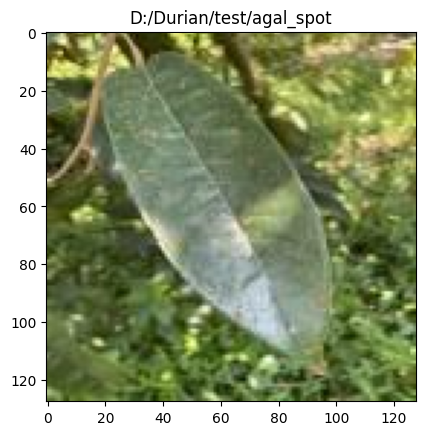

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot087_jpg.rf.d0fd144d3736c3b0cc3ecef30aa7a53c.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6723529  0.03262533 0.18475886 0.08750714 0.02275566]]
predict : agal_spot


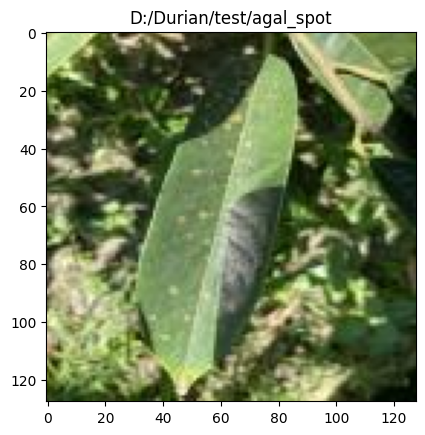

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot089_jpg.rf.fc21288b78c4894d3eb55b720a08274e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[9.0478772e-01 2.8075172e-02 8.5671619e-04 6.0426977e-02 5.8534341e-03]]
predict : agal_spot


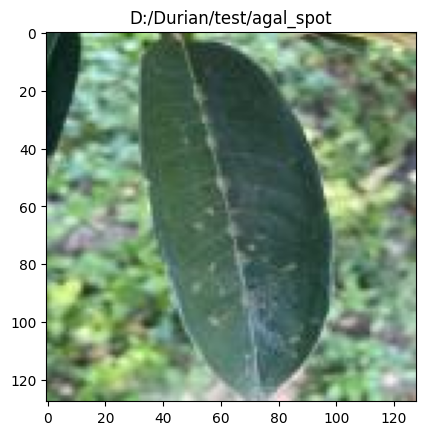

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot091_jpg.rf.2a832d15589b1619d63bd9b65edfb91d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.76147866 0.08027487 0.08055098 0.05523271 0.02246279]]
predict : agal_spot


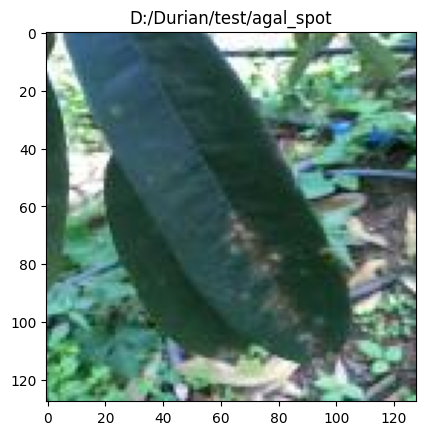

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot095_jpg.rf.6124266c850b593cccc44e19d9d06976.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.60172516 0.00863595 0.13518275 0.23252065 0.02193554]]
predict : agal_spot


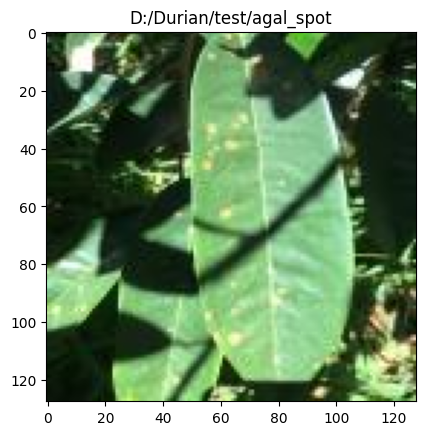

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot096_jpg.rf.592eb30a2abbf46429d5ec4f52538fcd.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.5811108  0.03547211 0.36166808 0.01073089 0.01101808]]
predict : agal_spot


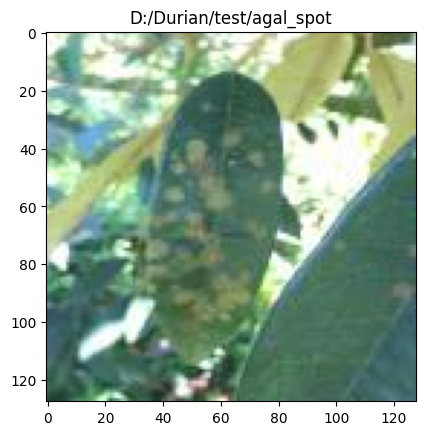

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot098_jpg.rf.c5f601fb6efb93396753b150881d0cb9.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.28435028 0.01662996 0.63313764 0.04984185 0.0160403 ]]
predict : left_blinght


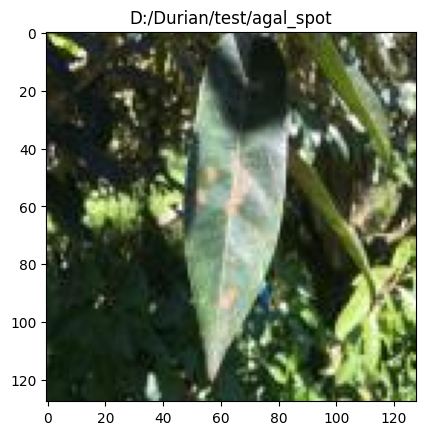

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot099_jpg.rf.2dda4c5f9a7e3515e60aa6d6e71e4e38.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.84850436 0.00334101 0.09207525 0.04796824 0.0081112 ]]
predict : agal_spot


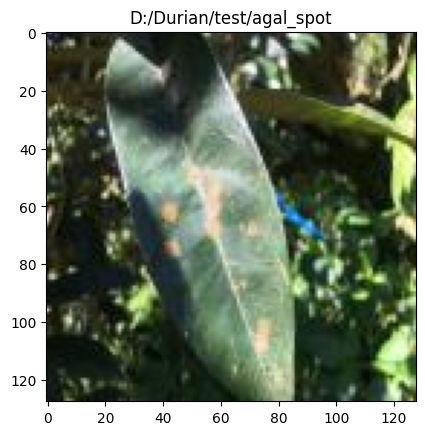

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot103_jpg.rf.fcb9bf37b1935c77073d2188b435ef52.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.52964157 0.00788342 0.43421885 0.01935821 0.00889793]]
predict : agal_spot


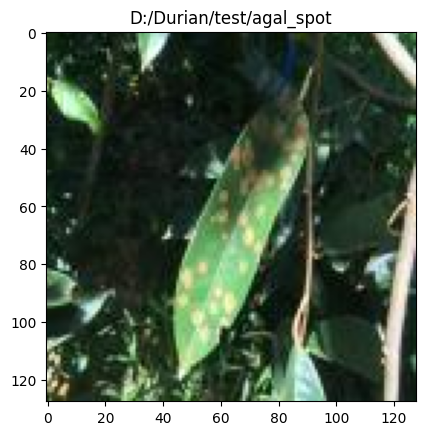

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/agal_spot\AlgalLeafSpot105_jpg.rf.f600c63eb3aba7f1de54afc851261c87.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6665269  0.32596672 0.00082973 0.00339325 0.00328346]]
predict : agal_spot


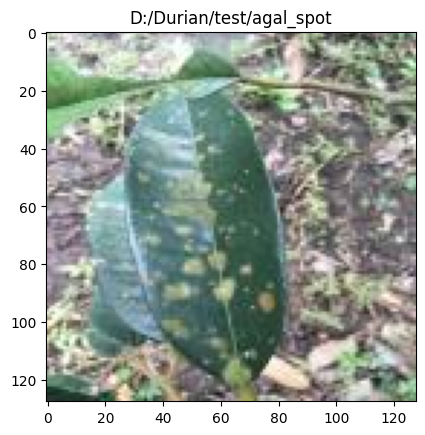

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\C8DCBD04-F06F-4E22-9FA0-8D9E7E874C34.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.11038493 0.21913396 0.57755446 0.06017512 0.03275151]]
predict : left_blinght


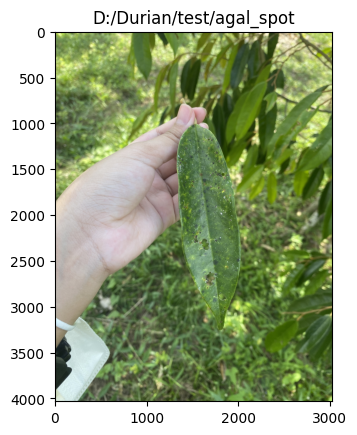

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/agal_spot\E64075E2-AF7A-4B51-92B0-016BB02F0AAB.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.30272985 0.06877709 0.36199436 0.21918878 0.04730998]]
predict : left_blinght


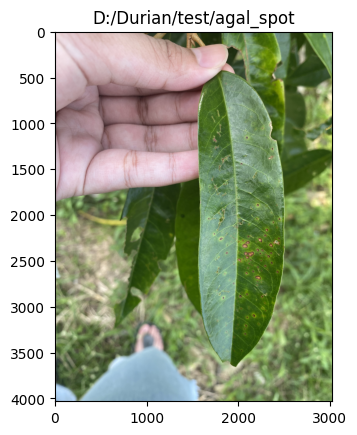

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\0012_0092_JPG.rf.240cfa0af0a2bee769f18071fd67fd9f.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[9.4122934e-06 9.9981886e-01 1.1473018e-04 3.2594962e-06 5.3698488e-05]]
predict : Anthracnose


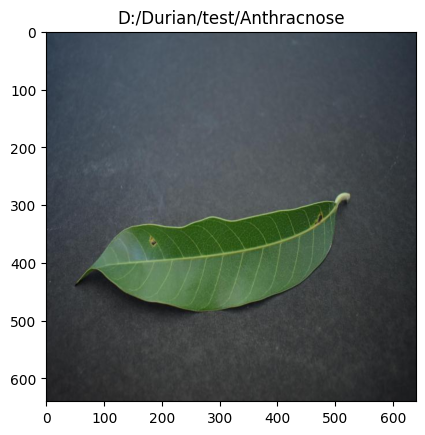

1/1 [==============================] - 0s 17ms/step
file : D:/Durian/test/Anthracnose\0012_0093_JPG.rf.7e574961302825be5c71b2839fe845f0.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.0710686e-05 9.9980694e-01 1.2635560e-04 2.9735352e-06 5.2993611e-05]]
predict : Anthracnose


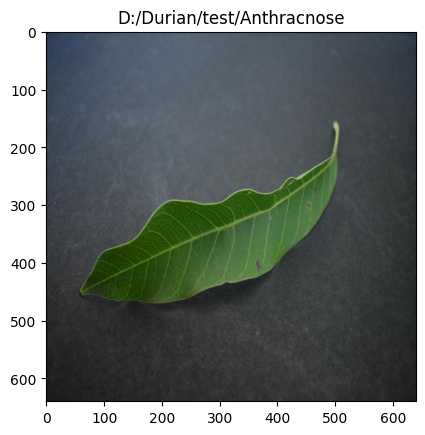

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\0012_0094_JPG.rf.d81cb8ef9fa88347a3c6d32c2c86849b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.6100170e-05 9.9909580e-01 7.8762666e-04 4.3004125e-06 9.6236974e-05]]
predict : Anthracnose


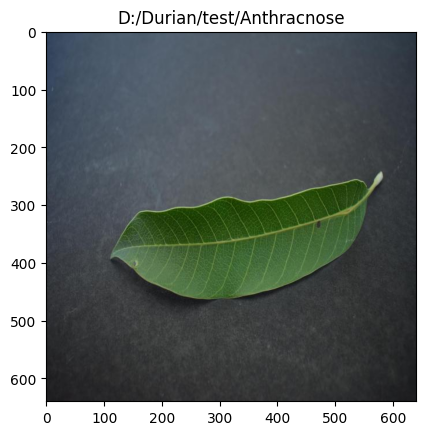

1/1 [==============================] - 0s 23ms/step
file : D:/Durian/test/Anthracnose\0012_0095_JPG.rf.65a6e1d38734f6111da1ed1a61ce5e4f.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.0034217e-06 9.9988270e-01 4.2310650e-05 9.4529987e-06 5.9647555e-05]]
predict : Anthracnose


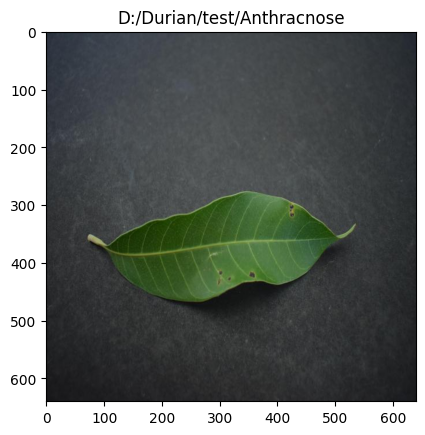

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\01BC1D2C-7676-4A9B-B23E-0C172C8FB135.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[4.6158221e-04 9.9776292e-01 9.1631105e-04 1.9749507e-04 6.6162250e-04]]
predict : Anthracnose


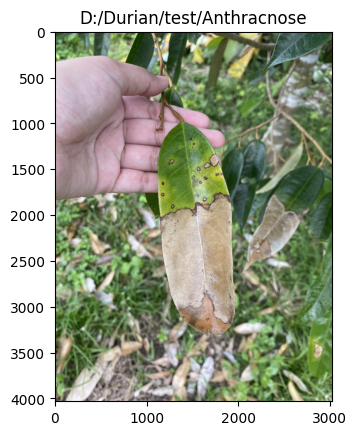

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\0E806FD1-F35E-478A-ABF0-981561AD88BE.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.49730968 0.21504173 0.05808839 0.19244304 0.03711705]]
predict : agal_spot


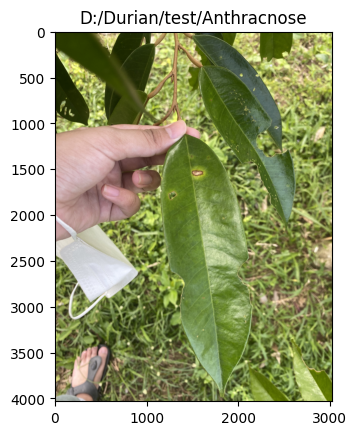

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211008_124252--Custom-_jpg.rf.7dcdd499bae7bbe8488423d8b33ffea8.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.1524035e-03 9.8642343e-01 4.4938433e-03 8.4734632e-04 2.0829826e-03]]
predict : Anthracnose


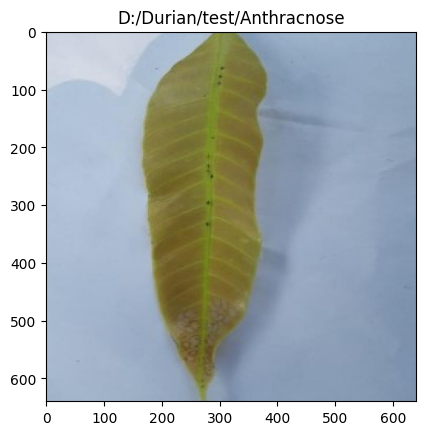

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211008_124253--Custom-_jpg.rf.16f82899953fe57b747fba967c99a0b9.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.5559218e-03 9.9086589e-01 3.6677530e-03 4.5869721e-04 1.4517634e-03]]
predict : Anthracnose


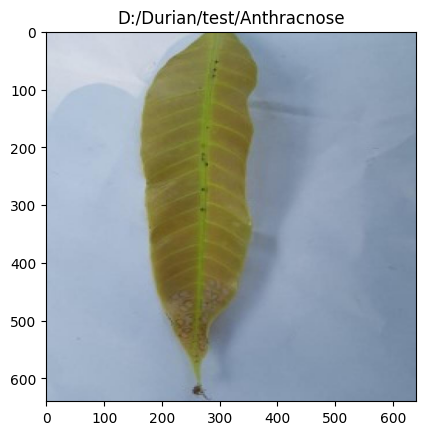

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211008_124256--Custom-_jpg.rf.7a9f7ca8ebcdd3128d50327d80e30906.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0554765  0.89174056 0.04492607 0.00182168 0.00603522]]
predict : Anthracnose


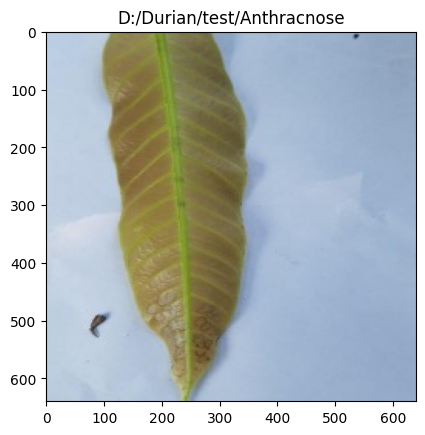

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211008_124301--Custom-_jpg.rf.67abbbede9e6f9bf4317f0357ad27a09.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.5913775e-04 9.9863005e-01 8.8498223e-04 4.2495551e-05 2.8329570e-04]]
predict : Anthracnose


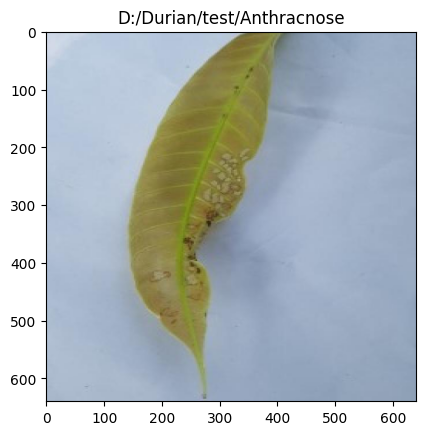

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211008_124305--Custom-_jpg.rf.802d07c716be92df97256a6094b2674d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00244644 0.9735206  0.01672615 0.00271765 0.00458919]]
predict : Anthracnose


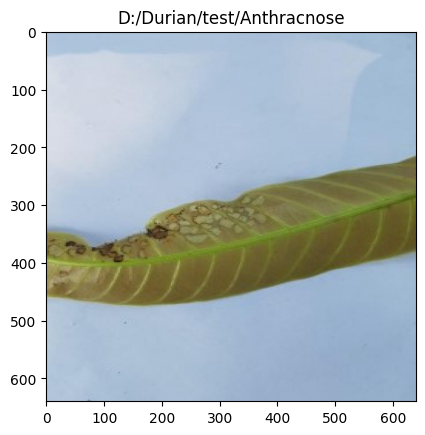

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\20211008_124306--Custom-_jpg.rf.eee55b88d88b6d53d55c9fb7e6e62386.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.1271976e-04 9.9808770e-01 1.4454786e-03 3.7778071e-05 3.1632671e-04]]
predict : Anthracnose


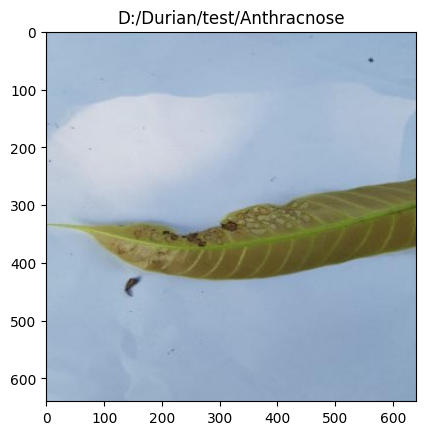

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_133423--Custom-_jpg.rf.a309b9dcd93052afe66649c68ba30c48.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.8141759e-02 9.5965290e-01 8.4380051e-03 8.7607797e-04 2.8913028e-03]]
predict : Anthracnose


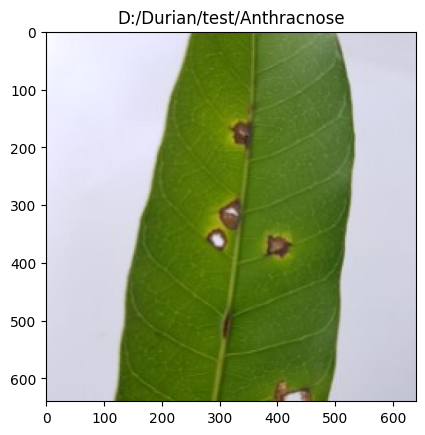

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_133426--Custom-_jpg.rf.aa88c58895dcef5b7fe863b5b1583554.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.0347077e-02 9.8240525e-01 5.0727716e-03 4.1781354e-04 1.7570974e-03]]
predict : Anthracnose


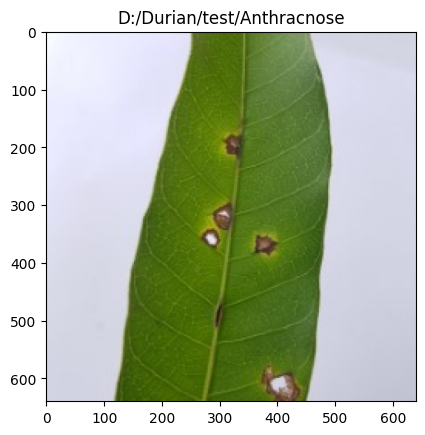

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_133430--Custom-_jpg.rf.38068a0d08a1d1de208346124cc85779.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.2021378e-03 9.9110854e-01 3.5586930e-03 5.4700393e-04 1.5836296e-03]]
predict : Anthracnose


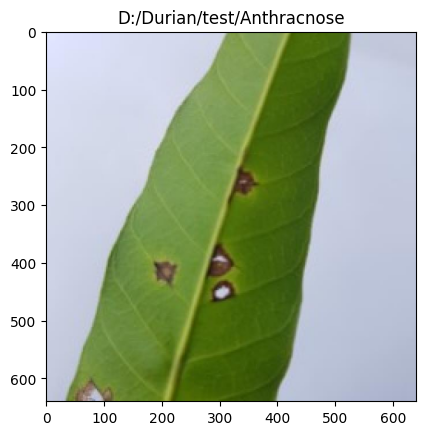

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_133431--Custom-_jpg.rf.171539cea45affe026ebfdc04a63b7f4.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[4.7066619e-04 9.9468720e-01 3.5727227e-03 2.9049435e-04 9.7890594e-04]]
predict : Anthracnose


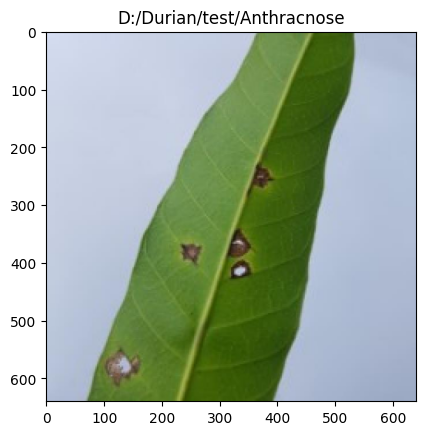

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_133436--Custom-_jpg.rf.22fb0249ca80da89f11e835c54c01e8f.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.2311483e-03 9.9726957e-01 1.7056876e-05 9.0918096e-04 5.7306420e-04]]
predict : Anthracnose


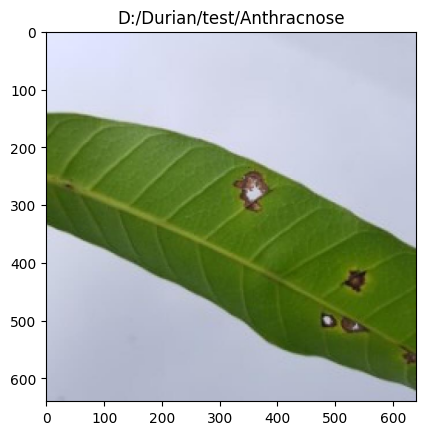

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_133438--Custom-_jpg.rf.060fcdd597ccd23644acf8c89a72f12b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.7256666e-03 9.8638135e-01 2.3432082e-04 4.4938121e-03 2.1648752e-03]]
predict : Anthracnose


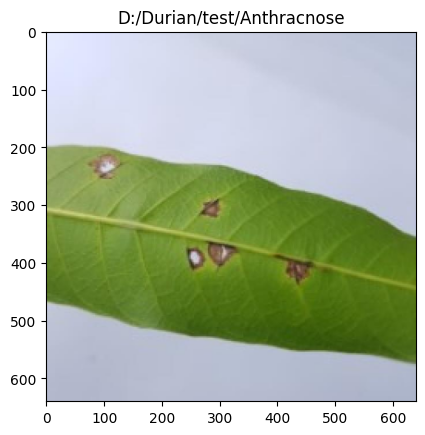

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\20211011_133745--Custom-_jpg.rf.0631654d88bbed6608a205fd39b02e39.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.13945314e-05 9.99858260e-01 3.62661704e-05 1.20138975e-05
  7.20665485e-05]]
predict : Anthracnose


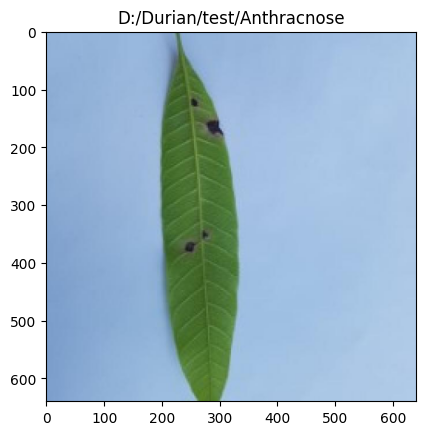

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_133751--Custom-_jpg.rf.aff338dcedadc03b347301186b75e17b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.2484874e-03 9.8369771e-01 1.3606770e-02 1.8678413e-04 1.2602838e-03]]
predict : Anthracnose


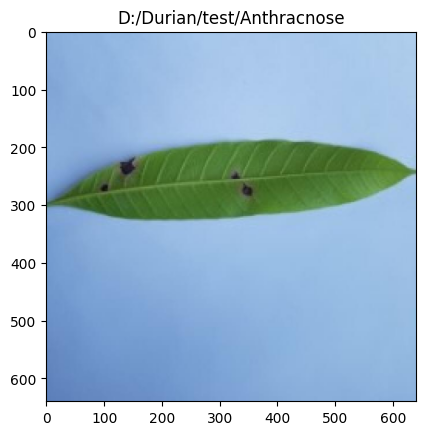

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\20211011_133757--Custom-_jpg.rf.3102b13c336f618a282c5b56d4f5fe31.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.8675863e-05 9.9989736e-01 3.1008916e-05 5.2388168e-06 4.7642396e-05]]
predict : Anthracnose


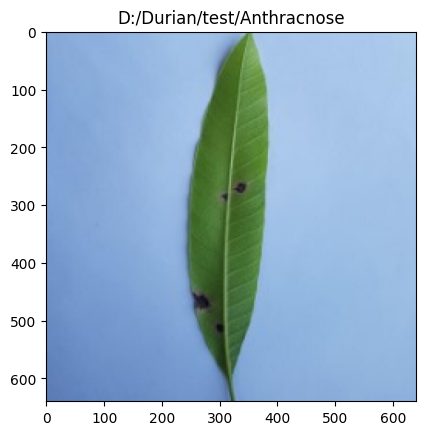

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_133805--Custom-_jpg.rf.88500778460d8b4478379e3028d65acc.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.7616552e-05 9.9992096e-01 9.6511894e-06 2.3389157e-06 2.9298344e-05]]
predict : Anthracnose


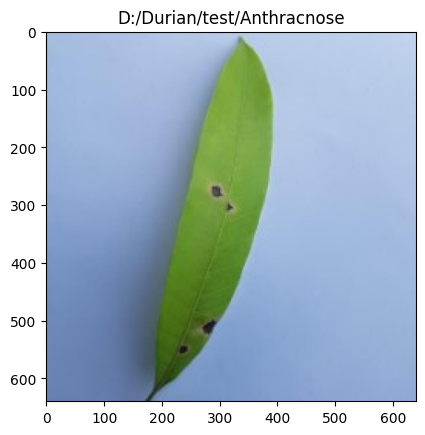

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\20211011_133809--Custom-_jpg.rf.6ec00182c563eccf9f608bce3180cf61.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.9759329e-05 9.9983072e-01 5.0265964e-05 1.5131679e-05 8.4001615e-05]]
predict : Anthracnose


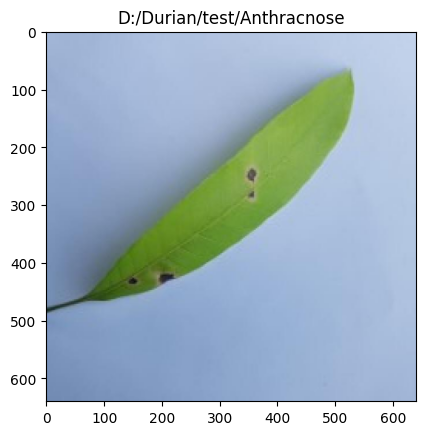

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\20211011_133815--Custom-_jpg.rf.355b3899d381ae90b44b5eda7e7bffff.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.3364256e-04 9.6577394e-01 3.3416528e-02 3.8160011e-05 6.3773245e-04]]
predict : Anthracnose


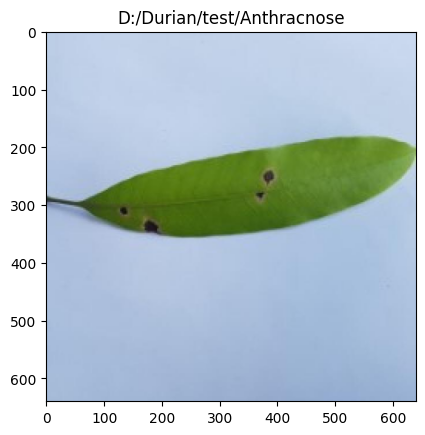

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_133956--Custom-_jpg.rf.7f18f3d49720aa85232f3bd23a69d6d9.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[4.4392323e-04 9.9834073e-01 9.5824199e-04 1.7490962e-05 2.3955753e-04]]
predict : Anthracnose


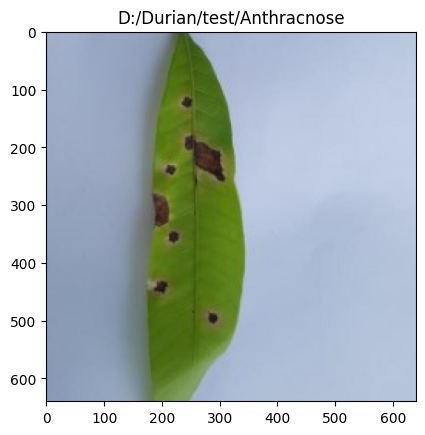

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_165905--Custom-_jpg.rf.f7ff927bd8bd80a9516d95409bd07929.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.7748551e-06 9.9990046e-01 6.0518007e-05 1.5312655e-06 3.0611791e-05]]
predict : Anthracnose


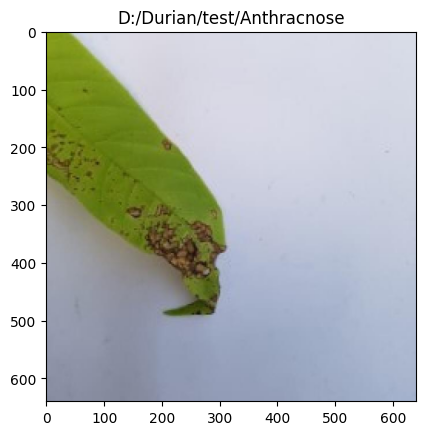

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_165908--Custom-_jpg.rf.f9b00fdc8da49fcd15e6cf787fa9b0e6.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.9276607e-03 9.9737561e-01 1.8228257e-04 1.0150392e-04 4.1290341e-04]]
predict : Anthracnose


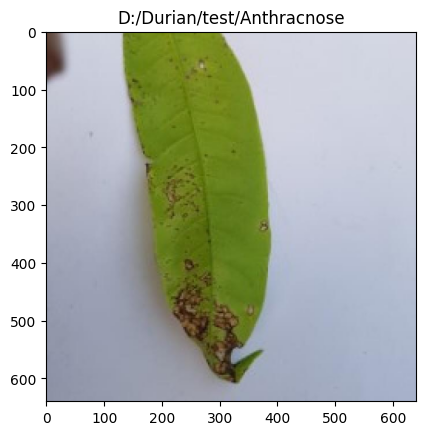

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_165910--Custom-_jpg.rf.16d938ae1bed5ea0a10758eaf7802f44.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[5.7709793e-05 9.9863571e-01 1.1197946e-03 1.1930778e-05 1.7473713e-04]]
predict : Anthracnose


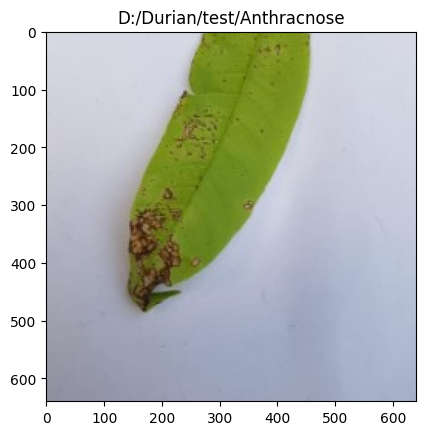

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_165914--Custom-_jpg.rf.ab9e684757b2d50e837b90cc5928d0f4.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[8.5756838e-05 9.9968040e-01 9.0441237e-05 1.8835599e-05 1.2449401e-04]]
predict : Anthracnose


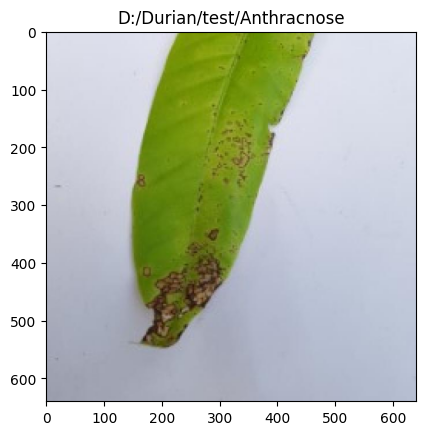

1/1 [==============================] - 0s 22ms/step
file : D:/Durian/test/Anthracnose\20211011_165916--Custom-_jpg.rf.4b462597957229589276cf560ef6953a.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.8310828e-05 9.9980181e-01 2.3971703e-05 4.8313741e-05 1.0763698e-04]]
predict : Anthracnose


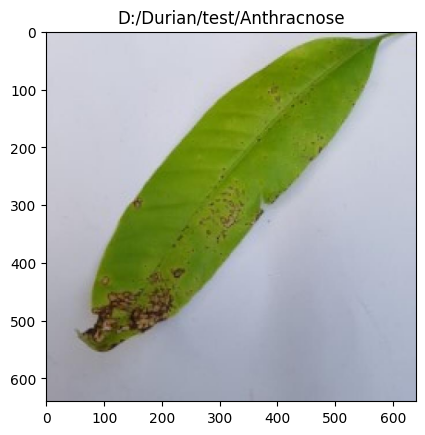

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\20211011_165919--Custom-_jpg.rf.fbda4e1da3ce38ee845acad2fe4826dc.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.0214437e-04 9.9932861e-01 2.1374704e-04 7.8046971e-05 2.7761637e-04]]
predict : Anthracnose


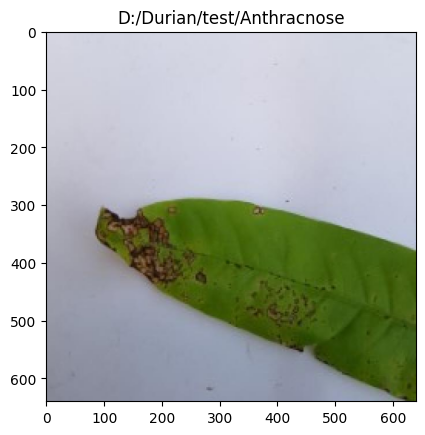

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\20211011_165922--Custom-_jpg.rf.5deacab22699623e789cbd31c5050d1e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.4166154e-05 9.9970824e-01 1.8645098e-04 3.8884336e-06 6.7179608e-05]]
predict : Anthracnose


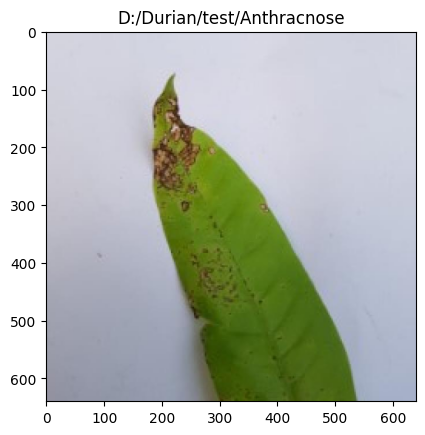

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\20211011_165925--Custom-_jpg.rf.de062b231fc2c8c4699e10df246797b3.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[4.8085049e-06 9.9990225e-01 7.4138523e-05 4.1399772e-07 1.8462968e-05]]
predict : Anthracnose


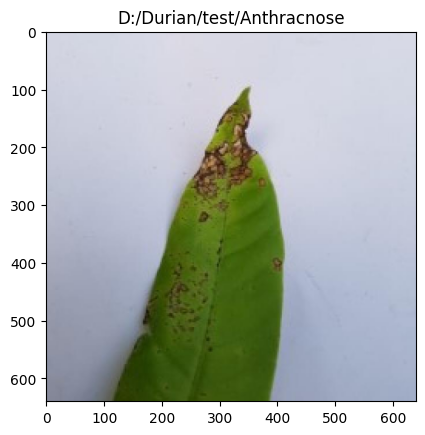

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\322DB71A-231C-40F4-9433-BA114F5AED06.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.3906027e-01 8.5464299e-01 2.9841805e-04 3.2351697e-03 2.7632054e-03]]
predict : Anthracnose


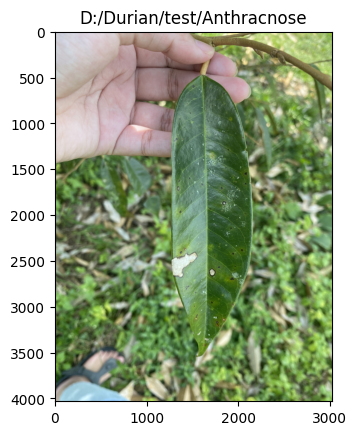

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\407D7727-C33A-418B-A4A3-3D06EF9ED28F.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.2940736  0.01003963 0.6036045  0.07316507 0.0191172 ]]
predict : left_blinght


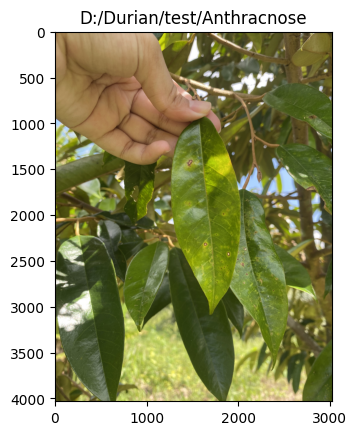

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\4DF052E2-27E1-45E3-BD9E-5DAEB0141CF4.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.18564543 0.76920116 0.00804272 0.02339821 0.01371238]]
predict : Anthracnose


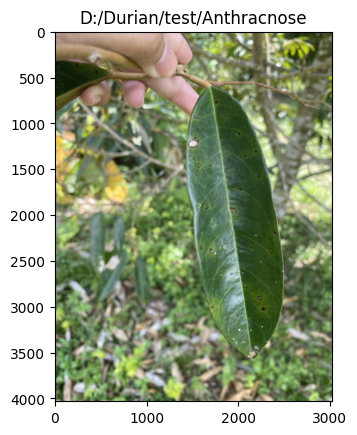

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\52493163-EED8-40F9-9418-6222224ECC78.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6900056  0.21458651 0.02399757 0.05297663 0.01843362]]
predict : agal_spot


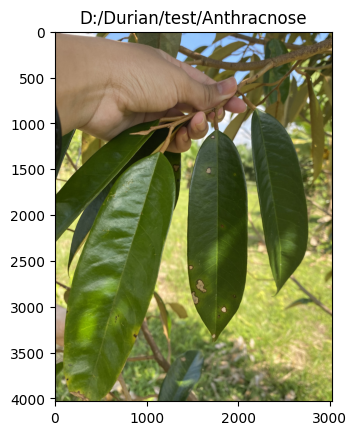

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\5BD8F913-574D-44E2-B48B-06E6EFB015DB.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01159373 0.88439345 0.09635217 0.00166574 0.00599499]]
predict : Anthracnose


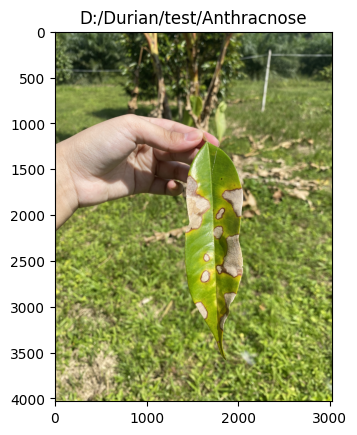

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\712E2112-F29C-497F-A77C-F8B23DC66621.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.37050396 0.04291957 0.499639   0.06233026 0.02460718]]
predict : left_blinght


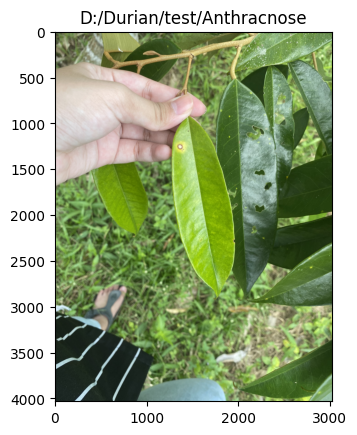

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\759BDEF8-F9FD-41D7-B354-112ED85B904B.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.16759303 0.7768131  0.0336547  0.00927946 0.01265969]]
predict : Anthracnose


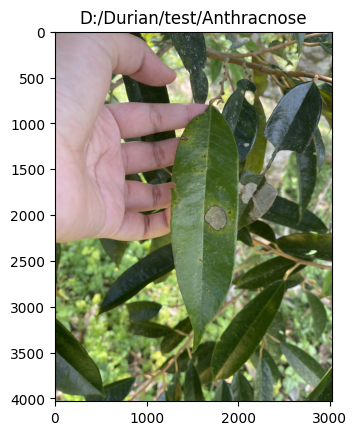

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\A67CFF67-A8FC-491B-803A-1BA7448FCEFF.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.68854517 0.0618242  0.00590902 0.22442964 0.01929201]]
predict : agal_spot


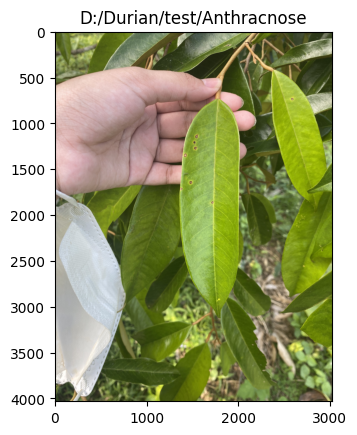

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\AB38113E-AF5E-47A1-BE5C-43E54E7C8C0F.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0917315  0.46294472 0.07561787 0.3197411  0.04996485]]
predict : Anthracnose


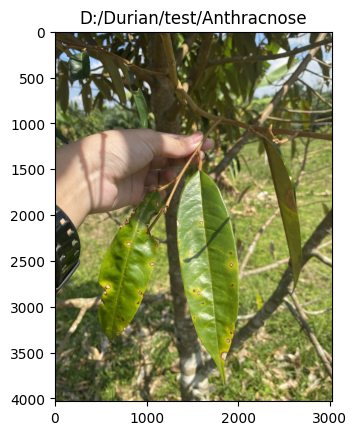

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\BD9D4F51-D597-476C-AD8E-4AC2296FC4B0.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00372321 0.97106016 0.01769091 0.00279662 0.00472917]]
predict : Anthracnose


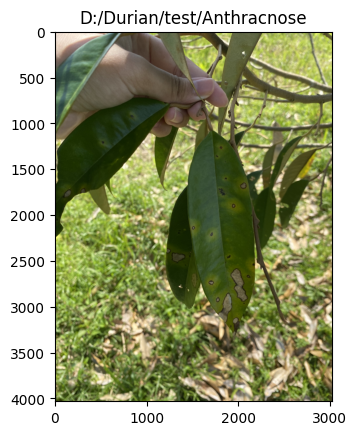

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/Anthracnose\D8D3295C-A3C0-42E6-BAD4-FCC17805FF44.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.8722745  0.02736995 0.00424803 0.08552516 0.01058235]]
predict : agal_spot


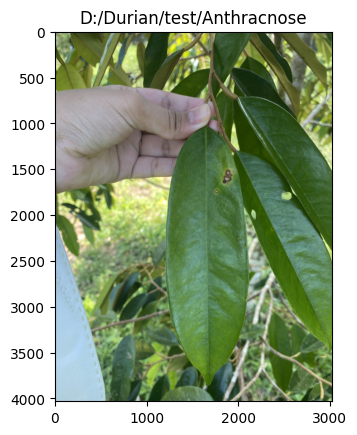

1/1 [==============================] - 0s 17ms/step
file : D:/Durian/test/Anthracnose\D93CB392-9823-46B1-BE81-8EBF4D708FB6.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[5.2749342e-04 9.9246830e-01 5.5419086e-03 2.2875659e-04 1.2335151e-03]]
predict : Anthracnose


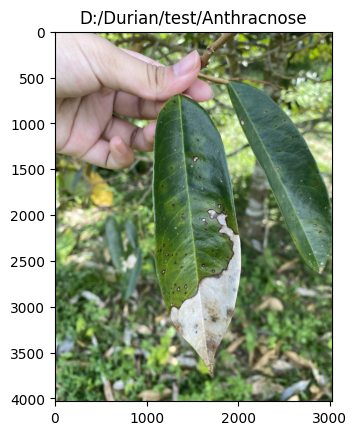

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_4725.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0461459  0.6211486  0.26148295 0.04219414 0.02902845]]
predict : Anthracnose


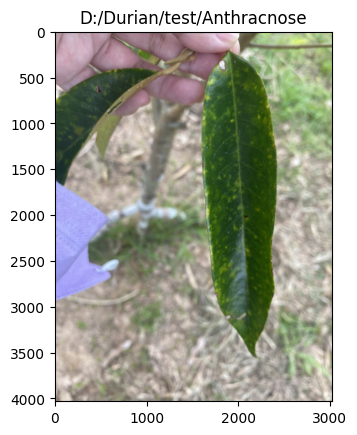

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_4727.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.26580092 0.72144    0.0062243  0.00192823 0.00460658]]
predict : Anthracnose


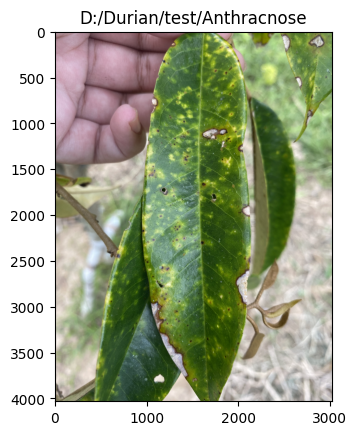

1/1 [==============================] - 0s 23ms/step
file : D:/Durian/test/Anthracnose\IMG_4728.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.74916184 0.20762692 0.00174974 0.0325496  0.00891184]]
predict : agal_spot


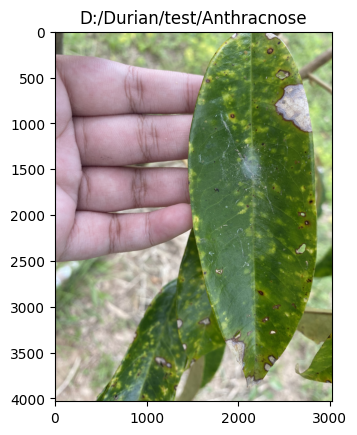

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_4730.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.03819897 0.9539862  0.00245145 0.00188716 0.00347625]]
predict : Anthracnose


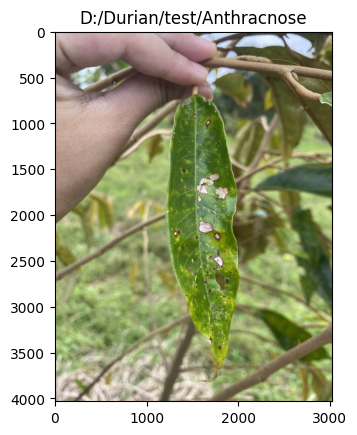

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\IMG_4731.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.48430154 0.03276595 0.23185372 0.21409121 0.0369876 ]]
predict : agal_spot


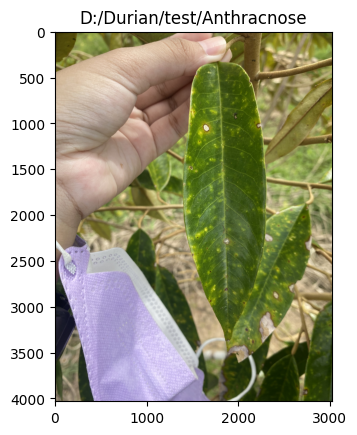

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_4740.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.79998213 0.16716696 0.00398041 0.02050072 0.00836974]]
predict : agal_spot


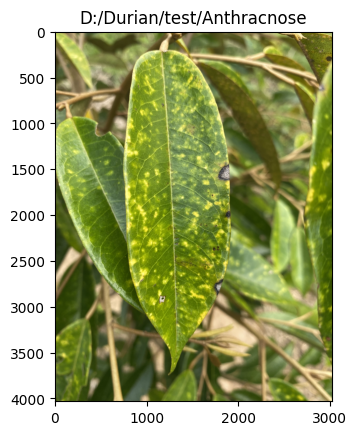

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_4974.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.68592596 0.17619371 0.04293027 0.07276171 0.02218835]]
predict : agal_spot


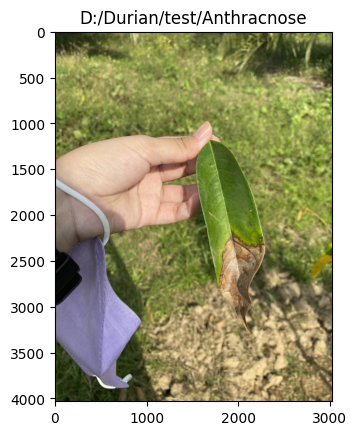

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\IMG_4977.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.2643707e-03 9.9683255e-01 1.3187183e-03 6.5421016e-05 5.1896379e-04]]
predict : Anthracnose


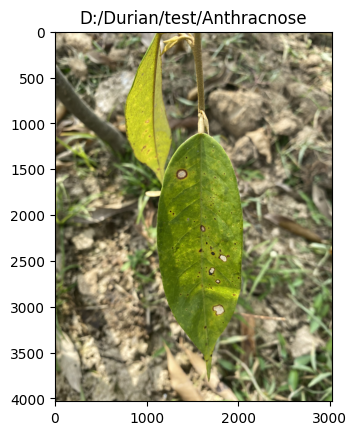

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\IMG_6850.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[7.7749006e-02 5.6490983e-04 9.1909122e-01 1.0872988e-03 1.5076393e-03]]
predict : left_blinght


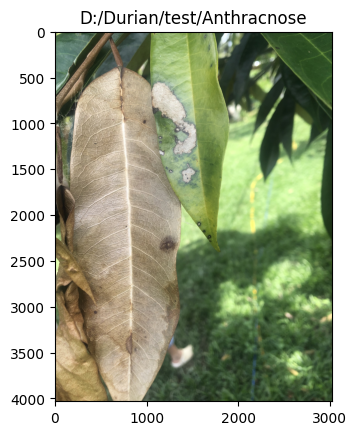

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_6869.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.1612352e-03 4.0772990e-03 9.9403703e-01 9.5555399e-05 6.2888704e-04]]
predict : left_blinght


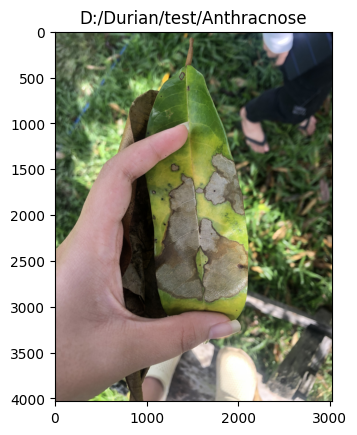

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/Anthracnose\IMG_6872.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.23806366 0.00665816 0.73018837 0.01622099 0.00886879]]
predict : left_blinght


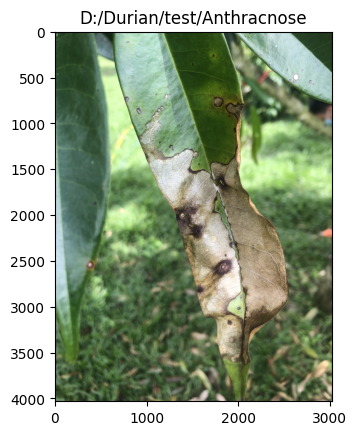

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_6873.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.1786591  0.00426999 0.7780268  0.0284708  0.01057338]]
predict : left_blinght


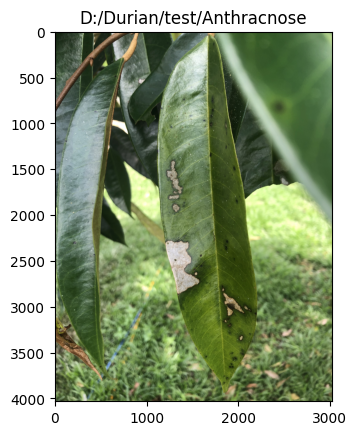

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/Anthracnose\IMG_6874.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.24841115 0.00966382 0.7061129  0.02279274 0.01301935]]
predict : left_blinght


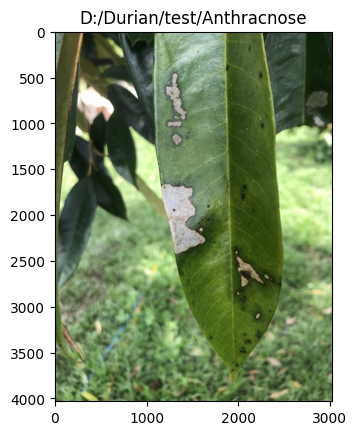

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\IMG_3330.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.0363022e-04 2.2942500e-02 9.7625095e-01 4.1312036e-05 5.6164165e-04]]
predict : left_blinght


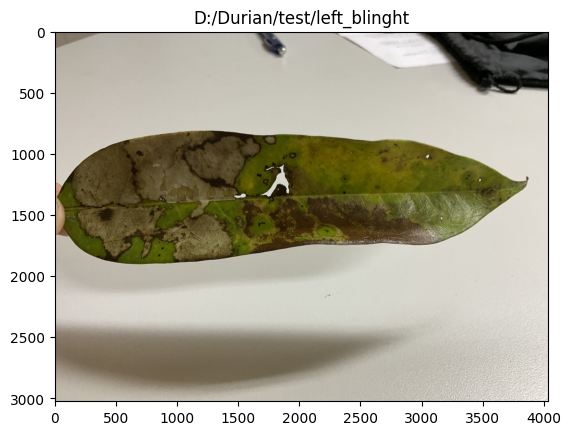

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\IMG_3332.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.7430337e-05 2.7387708e-03 9.9708074e-01 1.0283699e-05 1.4257481e-04]]
predict : left_blinght


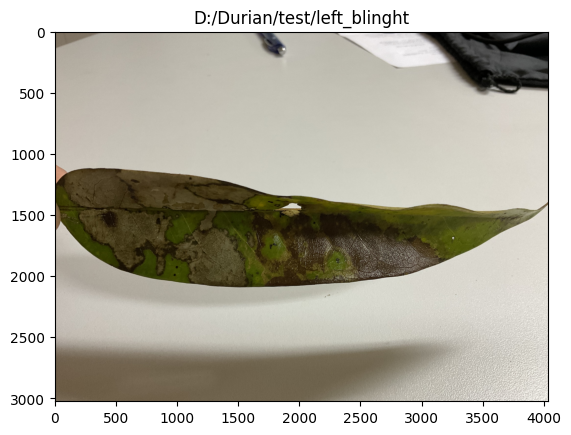

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\IMG_3334.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[7.3214332e-03 6.6859108e-01 3.1899527e-01 4.9566274e-04 4.5965416e-03]]
predict : Anthracnose


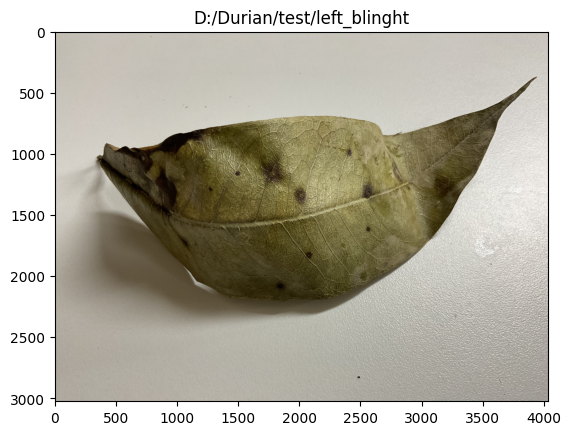

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/left_blinght\IMG_3335.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[8.70107114e-03 1.03848755e-01 8.84334266e-01 3.09769966e-04
  2.80618737e-03]]
predict : left_blinght


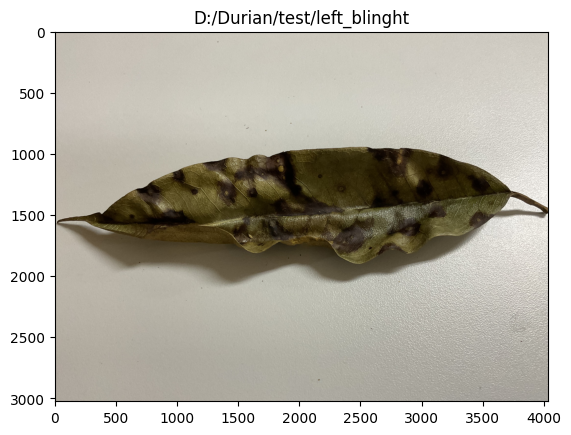

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight001_jpg.rf.8f46644ba85dc1a9f18597b6280e36cb.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0014601  0.9444162  0.04817833 0.00153535 0.00440998]]
predict : Anthracnose


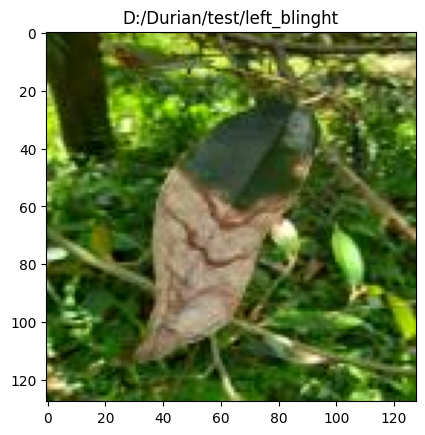

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight008_jpg.rf.46d0a2e63b02ff66c191a6b3737a7a34.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6157252  0.14669068 0.22383346 0.00383625 0.0099144 ]]
predict : agal_spot


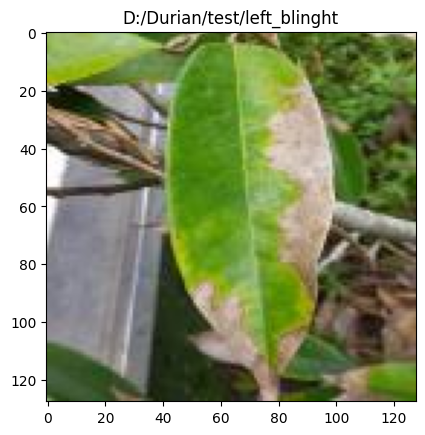

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight013_jpg.rf.b171f5a10af54b1b8bd5da3d213f7e3d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.4709828e-04 2.2448774e-02 9.7666055e-01 2.9592313e-05 5.1397650e-04]]
predict : left_blinght


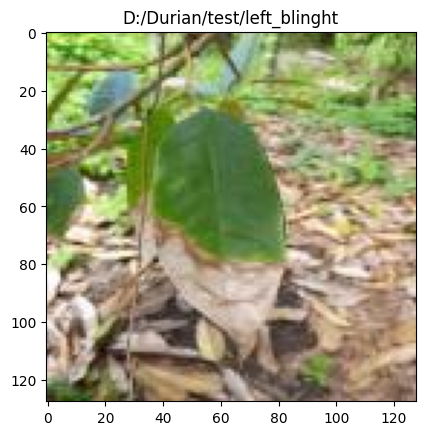

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight014_jpg.rf.407e32998bcf7a24cdd0d34747d7c237.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.04083801 0.00213158 0.9447389  0.00750675 0.0047847 ]]
predict : left_blinght


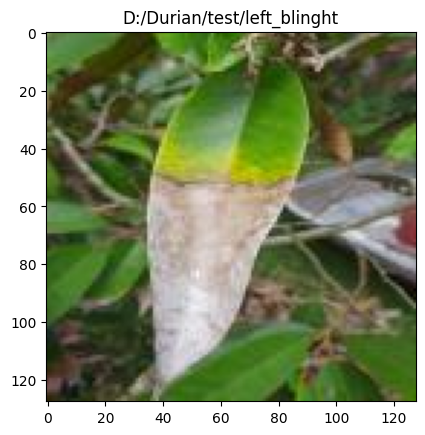

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight015_jpg.rf.2e12b25a372443d676ce182437fcd4b9.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.12968634 0.00498457 0.8463146  0.01159531 0.00741916]]
predict : left_blinght


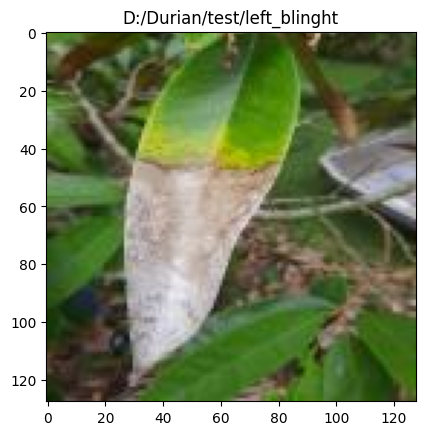

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight016_jpg.rf.1b4f837dd6acdf74b968c59bbcf29d9f.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.04779664 0.45698452 0.37075087 0.08314238 0.04132555]]
predict : Anthracnose


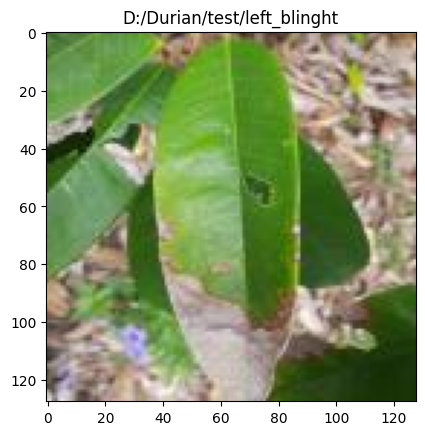

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/left_blinght\LeafBlight017_jpg.rf.206ecd0f30020a2f13f28faf5522f482.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.1480600e-02 2.7140116e-04 9.3581986e-01 1.1896337e-03 1.2383873e-03]]
predict : left_blinght


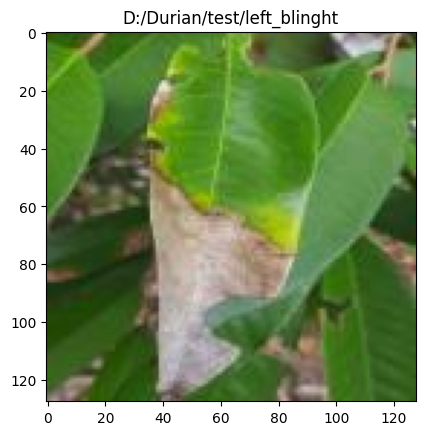

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight019_jpg.rf.270064cccd4a31310c826216de273a2d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.57667613 0.02915511 0.35808617 0.02109284 0.01498974]]
predict : agal_spot


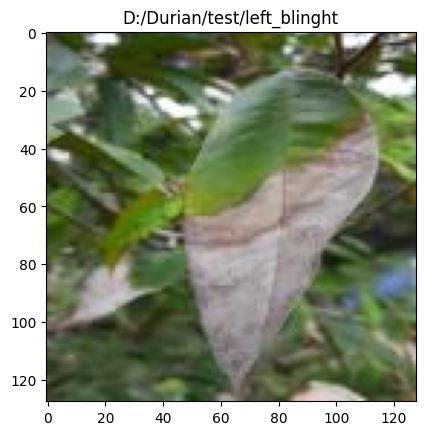

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight021_jpg.rf.2748553a15980b5c4f60264de391f14e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01224407 0.21455674 0.7608226  0.00305661 0.00932   ]]
predict : left_blinght


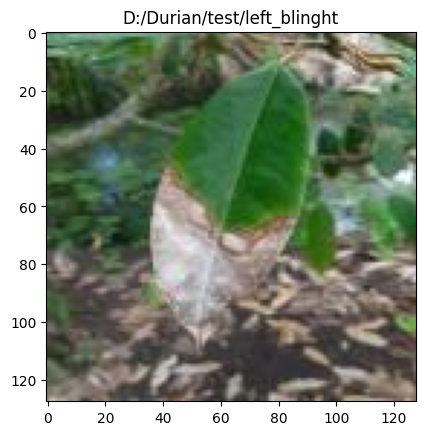

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/left_blinght\LeafBlight027_jpg.rf.39242a4dace0fb4f48ce4c0567ad3a80.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.3509076e-03 3.8255152e-05 9.9802196e-01 2.7289148e-04 3.1603599e-04]]
predict : left_blinght


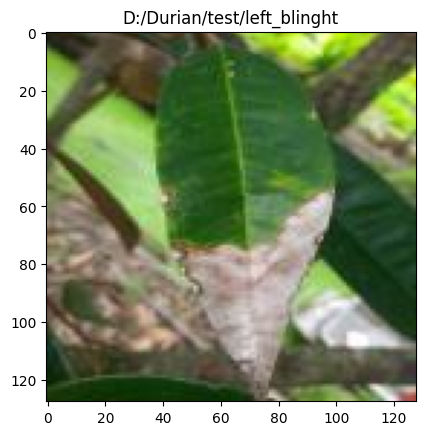

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/left_blinght\LeafBlight029_jpg.rf.991347b0e34edaf05a4e7439f692485c.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0128351  0.03434982 0.9481566  0.00096308 0.00369535]]
predict : left_blinght


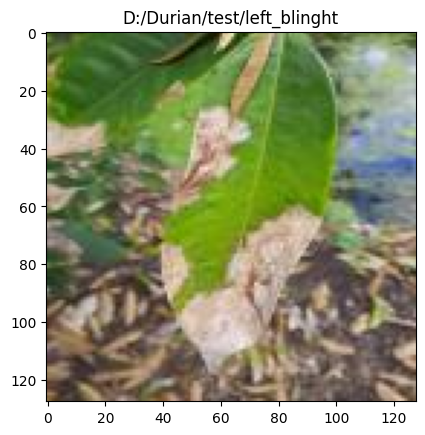

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight034_jpg.rf.0ab448bc67a5c826496a214f3da55fe1.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.0207364e-03 2.0188764e-03 9.9082863e-01 2.0048891e-04 9.3132781e-04]]
predict : left_blinght


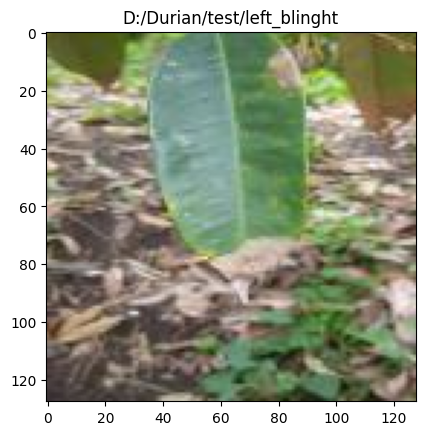

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight035_jpg.rf.3a5db39097c1df9c94edd95927274ef5.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.4522354e-03 4.3144133e-05 9.9243766e-01 5.9517153e-04 4.7184006e-04]]
predict : left_blinght


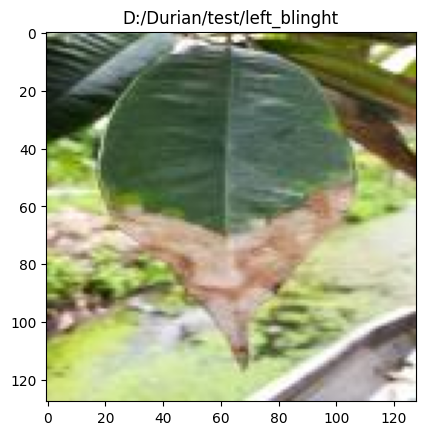

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight040_jpg.rf.df42ecb93fdbc39b60b0cbd11885f858.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.06233622 0.00142402 0.9326206  0.00152824 0.00209085]]
predict : left_blinght


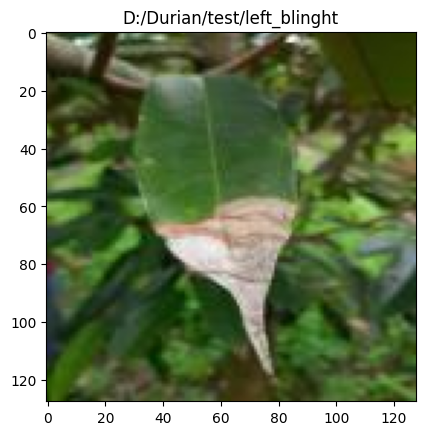

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight045_jpg.rf.66f5a2963f0100fd8ef26077651329eb.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[8.0472110e-03 3.1886046e-04 9.9085677e-01 2.4352731e-04 5.3366472e-04]]
predict : left_blinght


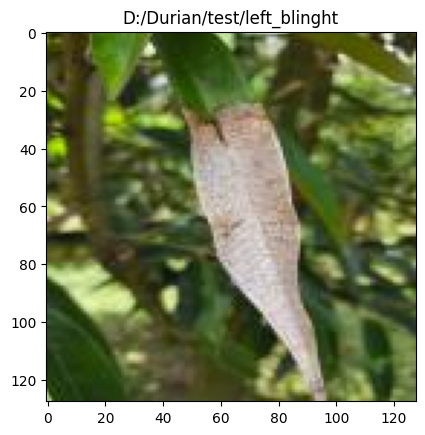

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight049_jpg.rf.1c41318a823c2b1f70fce5da21b0d979.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00228349 0.02326661 0.9665462  0.00342917 0.00447452]]
predict : left_blinght


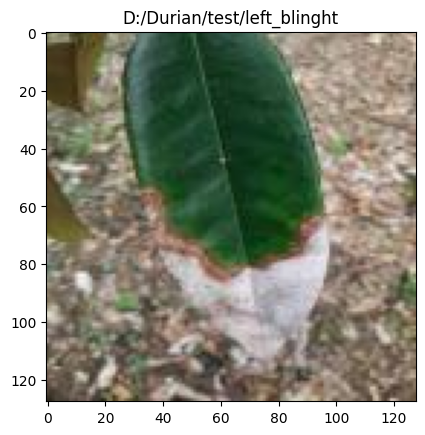

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight053_jpg.rf.9519432189476dff65d245f7295b2ed5.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.08801028 0.01305928 0.87464094 0.01422652 0.01006292]]
predict : left_blinght


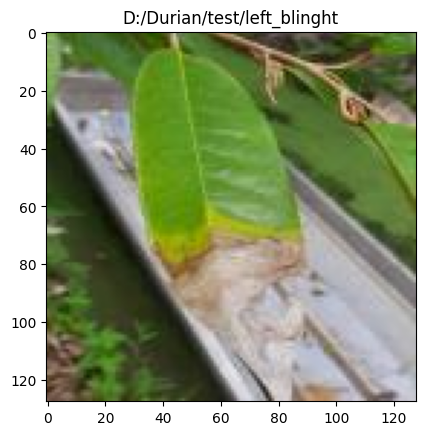

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight056_jpg.rf.b467b21d53777ee035fc334d95e19924.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[5.9447426e-04 9.9529250e-05 9.9862039e-01 3.5565652e-04 3.2982219e-04]]
predict : left_blinght


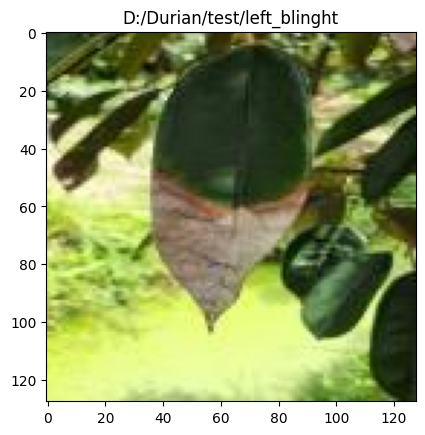

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/left_blinght\LeafBlight057_jpg.rf.cbfa5c9a3a5dc7599a502495213d931b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[5.3596275e-04 7.0057973e-02 9.2480528e-01 1.0978637e-03 3.5029061e-03]]
predict : left_blinght


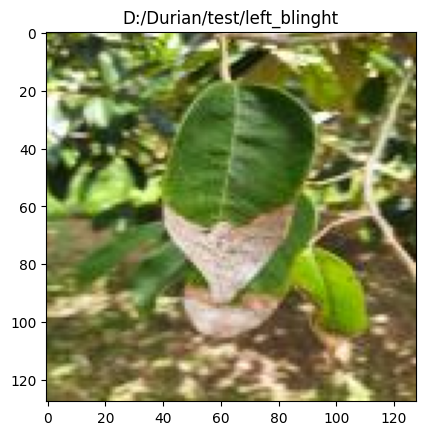

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight058_jpg.rf.d7c2e861c2f3d931457c84716266a0f8.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.02429045 0.02200885 0.9212167  0.0213359  0.01114802]]
predict : left_blinght


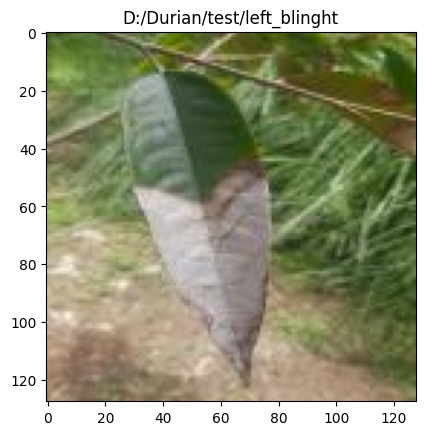

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight060_jpg.rf.9de3add245985e70db097c7f0dd13b37.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01346794 0.05305912 0.92750585 0.00136275 0.00460437]]
predict : left_blinght


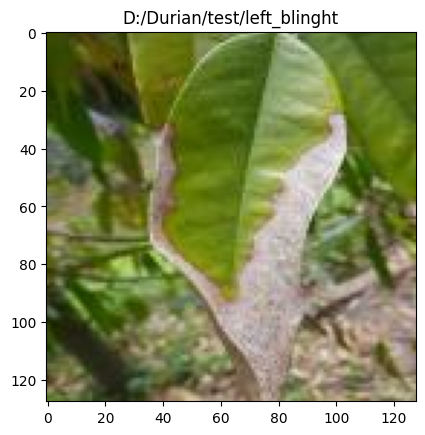

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight061_jpg.rf.ec330d7dd4622a29ed259d11d2ff7224.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.4676628e-03 3.8079962e-03 9.8854744e-01 1.9473478e-04 9.8224776e-04]]
predict : left_blinght


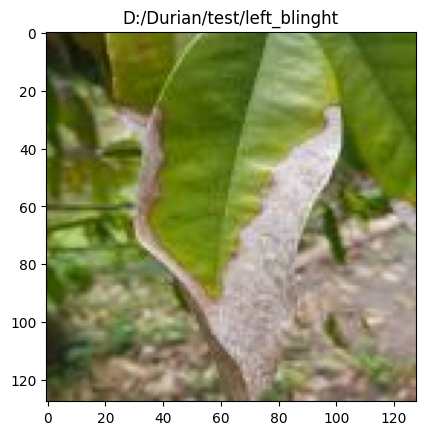

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight067_jpg.rf.b278a44b0edbe03d6ea134a9a0b53222.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.3908743e-02 3.7319525e-04 9.6341217e-01 1.1255413e-03 1.1803629e-03]]
predict : left_blinght


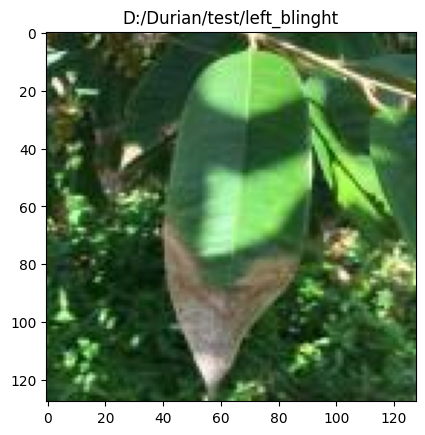

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight068_jpg.rf.4cfa1fd1593c60986a9b72db86572c6e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.0452172e-04 1.2043741e-02 9.8607522e-01 2.2210569e-04 1.0544386e-03]]
predict : left_blinght


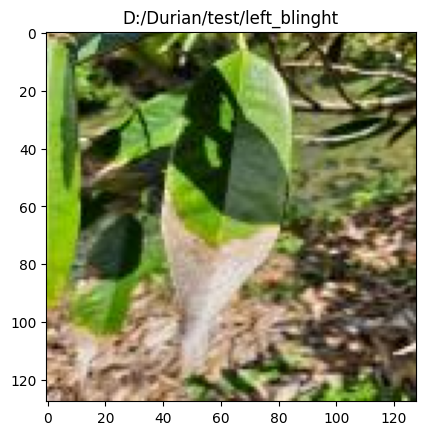

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight069_jpg.rf.fd1e437bfd7df0a837648dc4996d459b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.05792345 0.03527223 0.8900229  0.00746933 0.00931206]]
predict : left_blinght


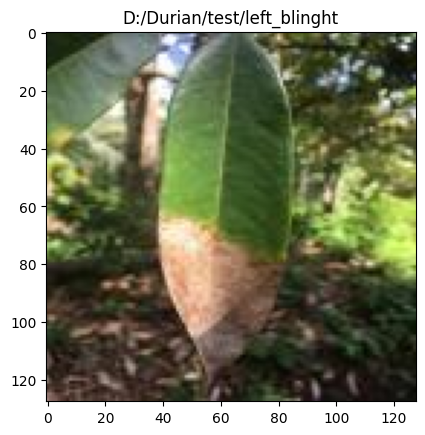

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight071_jpg.rf.4290960e0062483427c55d5719fcfe8e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.6882950e-03 9.1345421e-05 9.9682641e-01 1.2217961e-04 2.7179907e-04]]
predict : left_blinght


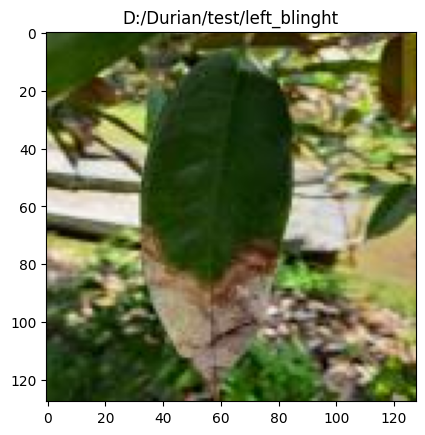

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight072_jpg.rf.dc9db0b2886169f3aaad7d6932fc4648.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.27225053 0.23055878 0.00999738 0.44927472 0.0379185 ]]
predict : normal


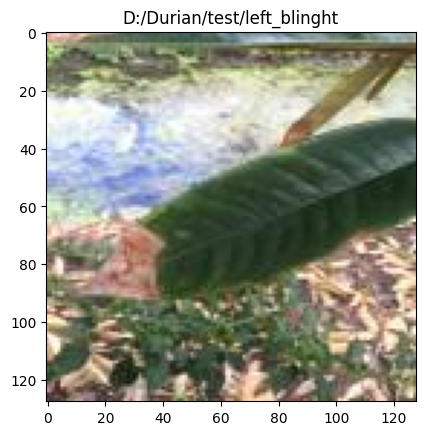

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/left_blinght\LeafBlight076_jpg.rf.ce4444a863e11857607d8798fbc585c5.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.18561652 0.04901882 0.6252135  0.10738339 0.03276781]]
predict : left_blinght


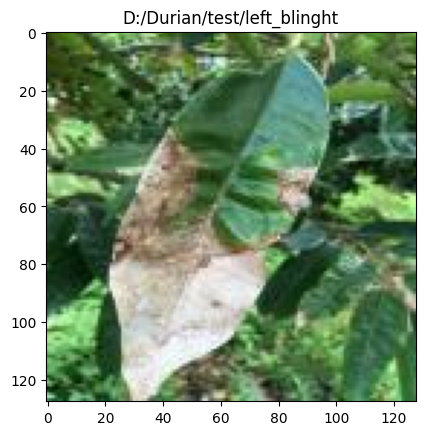

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight080_jpg.rf.2a345bf0e78142042ec1899b6819ba76.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.8851880e-02 6.6930393e-04 9.6255952e-01 5.2341162e-03 2.6851911e-03]]
predict : left_blinght


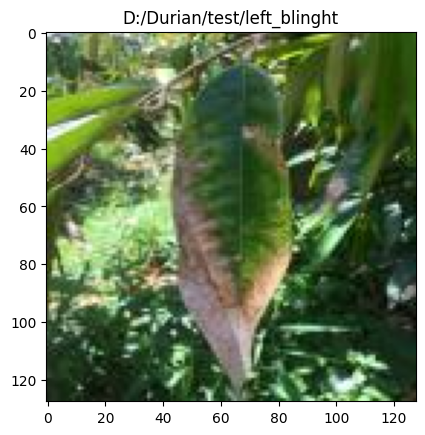

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight081_jpg.rf.8b0e35c22643e3453aeba9ee2c694455.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.02138929 0.01063439 0.95442814 0.0070695  0.00647873]]
predict : left_blinght


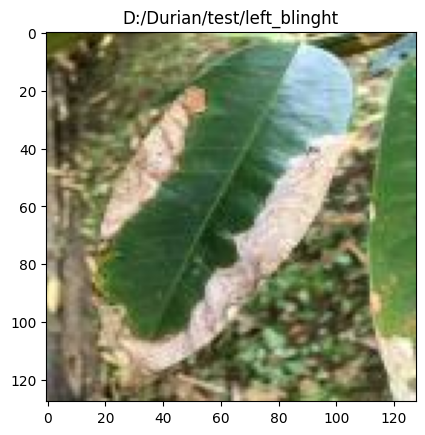

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight082_jpg.rf.8096f555884e5e4544ffef036086d295.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01568711 0.00140456 0.97978485 0.00128001 0.00184344]]
predict : left_blinght


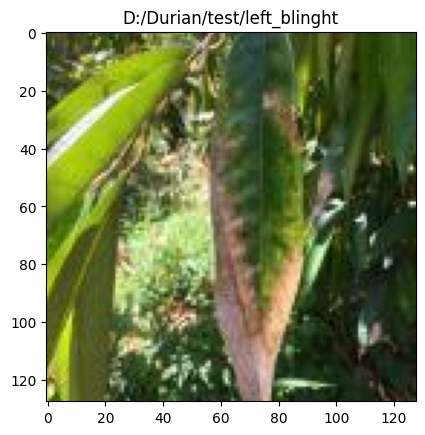

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight083_jpg.rf.5915bcba940c200f6c69250f3b833e2e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.20850319 0.01105731 0.7571137  0.01410524 0.00922057]]
predict : left_blinght


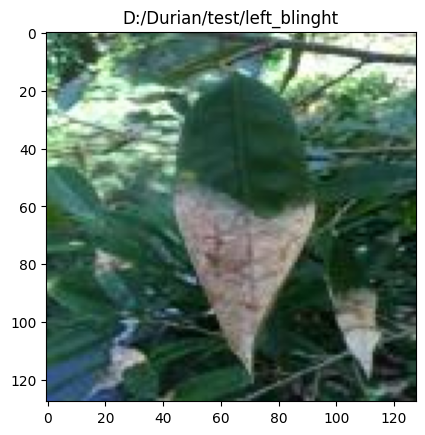

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight084_jpg.rf.755c882417b9b0006022b9e3f93e6461.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6580745  0.00224984 0.3247904  0.00973228 0.00515297]]
predict : agal_spot


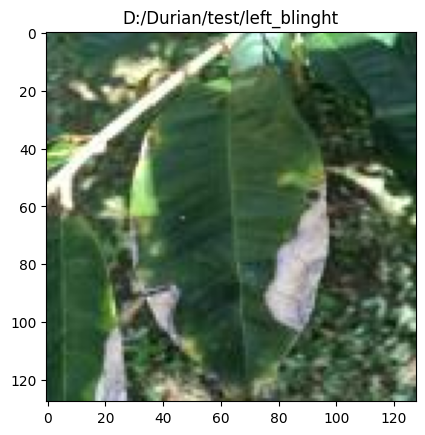

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight088_jpg.rf.316542089e02b682e52020bbc314a67f.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.3953199e-04 3.1242744e-05 9.9937052e-01 2.2943217e-04 2.2937026e-04]]
predict : left_blinght


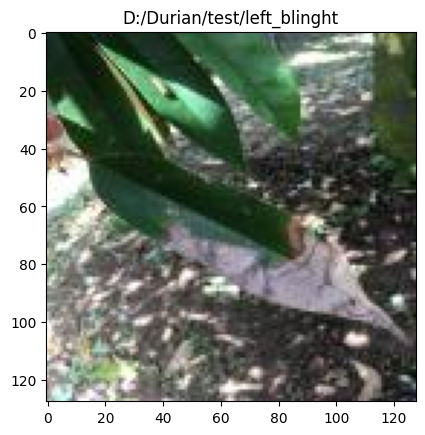

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight089_jpg.rf.e1d74cbefbc70c029d45a44990212f6c.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.02553977 0.02510544 0.8990132  0.03589875 0.01444272]]
predict : left_blinght


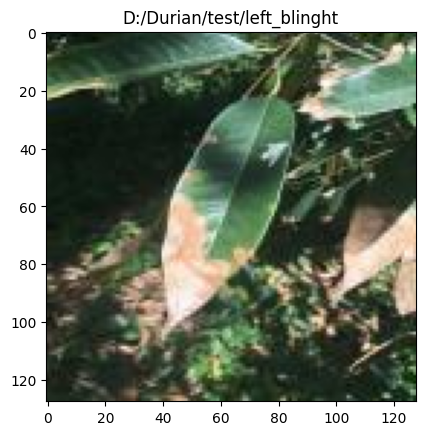

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/left_blinght\LeafBlight090_jpg.rf.1ea1f4bfc0d9294e99c61a46efcce79d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0067853  0.00485887 0.98281485 0.00227667 0.00326428]]
predict : left_blinght


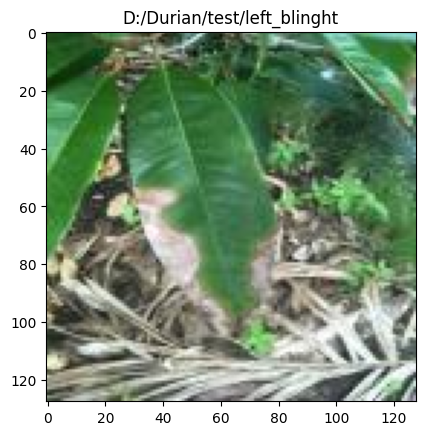

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/left_blinght\LeafBlight091_jpg.rf.6ebb161e713e5f1ebfa8a8e8fc28f393.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.4061210e-03 1.7330727e-02 9.7830874e-01 7.3403952e-04 2.2204495e-03]]
predict : left_blinght


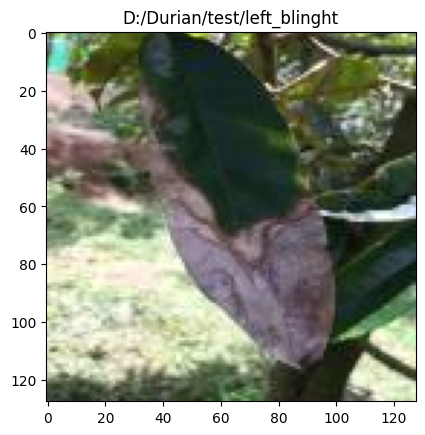

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight093_jpg.rf.c3a7d7c64ba9a08cf5a6985917e984ae.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0130907  0.881041   0.09730989 0.0019184  0.00663995]]
predict : Anthracnose


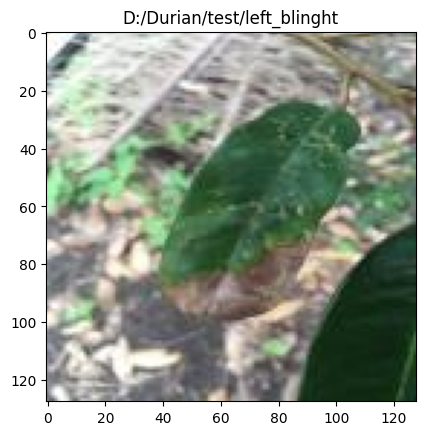

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight095_jpg.rf.8d81852e38e295a623423af169a58616.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00504681 0.00458631 0.9856011  0.00209141 0.00267436]]
predict : left_blinght


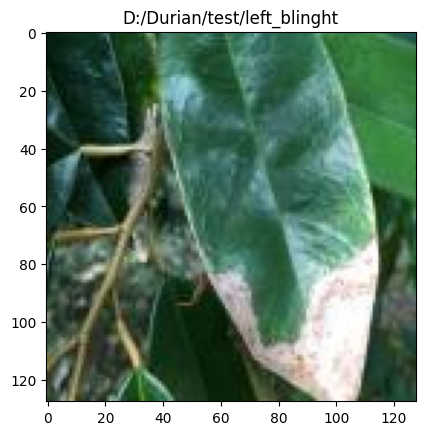

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight098_jpg.rf.0734745e5fe6af81d1b8b80d6680b442.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.07216077 0.00847691 0.9157481  0.00094337 0.00267085]]
predict : left_blinght


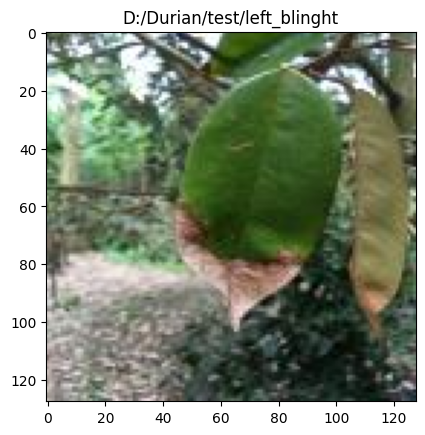

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight100_jpg.rf.4740d99d1601c8157cab1ac8c9da1366.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00519184 0.01650249 0.9469167  0.0205281  0.01086083]]
predict : left_blinght


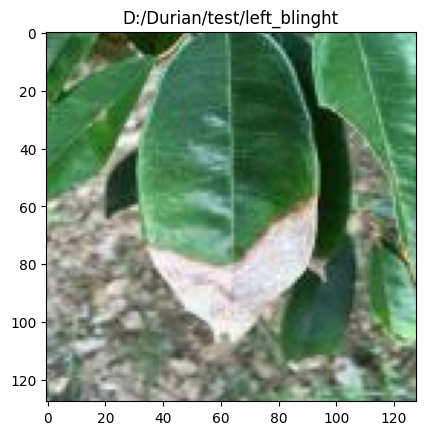

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight101_jpg.rf.2f2ee24c17b2fb91940151efc85e0096.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00397375 0.00100609 0.9907203  0.00220163 0.00209826]]
predict : left_blinght


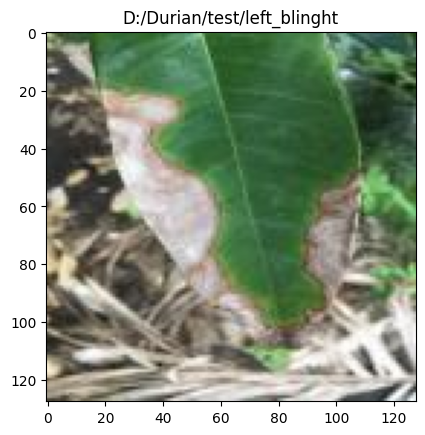

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/left_blinght\LeafBlight102_jpg.rf.252e90247e909cbcb8854f451f3679c4.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[4.6521722e-04 3.9010940e-03 9.9412739e-01 4.9279205e-04 1.0135090e-03]]
predict : left_blinght


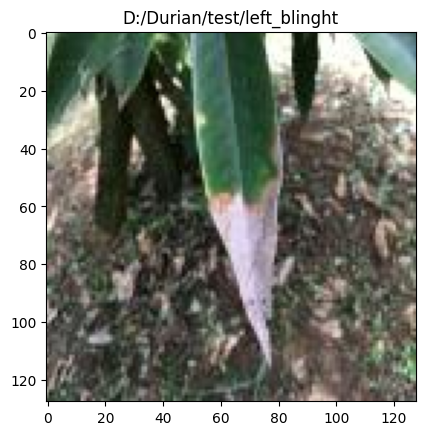

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/left_blinght\LeafBlight104_jpg.rf.dc24df839ddb4fd4f78667a38152d011.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.0899858e-03 7.8648634e-02 9.1556489e-01 3.0992896e-04 2.3865756e-03]]
predict : left_blinght


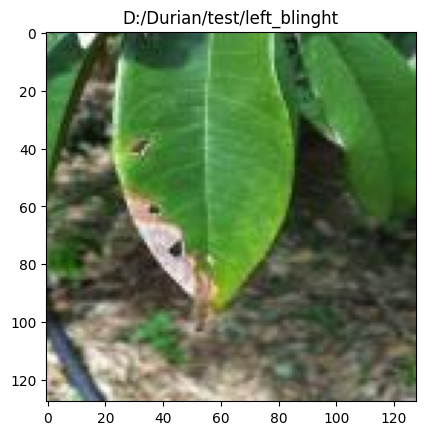

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\0CC659A1-DEDA-41D0-9D94-8618407FB8F6.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01307824 0.37583187 0.4796243  0.09322545 0.03824007]]
predict : left_blinght


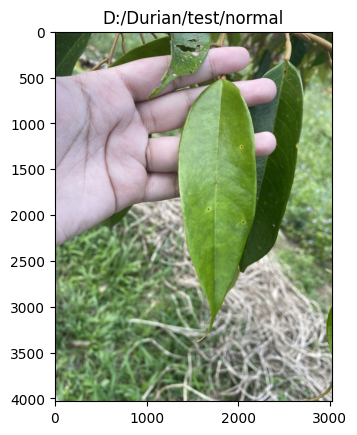

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\1EA2559C-E0D5-4D41-8B09-5B05BAD0F74B.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6948801  0.12103678 0.07242153 0.08541005 0.02625155]]
predict : agal_spot


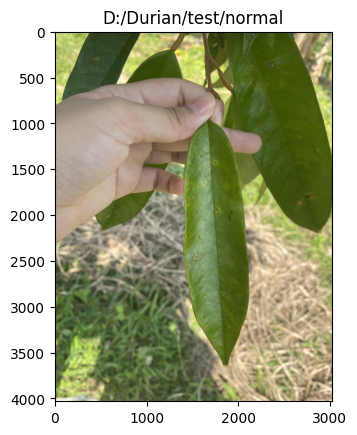

1/1 [==============================] - 0s 29ms/step
file : D:/Durian/test/normal\2BF0C295-28D6-44AA-9200-79563603307B.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.31787953 0.28720316 0.04921347 0.29927728 0.04642664]]
predict : agal_spot


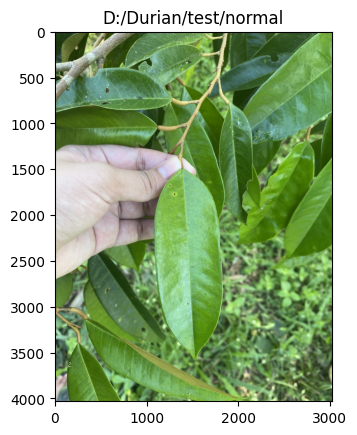

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\3F7C43E7-7196-4C7D-ABA8-3974AC5B35C2.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.71700805 0.0218673  0.09719243 0.14199217 0.02194002]]
predict : agal_spot


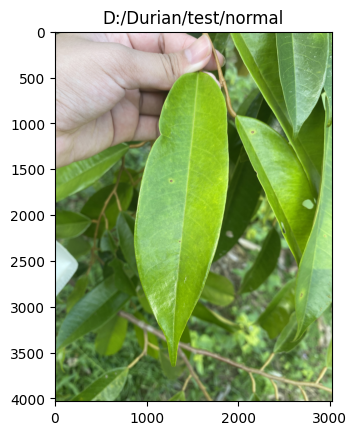

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease006_jpg.rf.3820c07c63f186f6952911a798b77a13.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.32046565 0.31414166 0.14129391 0.17366229 0.05043652]]
predict : agal_spot


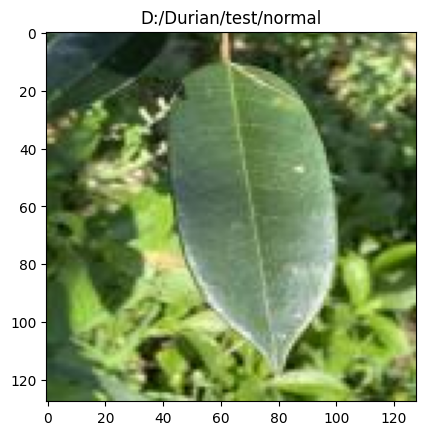

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease007_jpg.rf.34e26ef9988f6bcaf5525e568b851803.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.7391269  0.02727016 0.03863925 0.1728672  0.02209639]]
predict : agal_spot


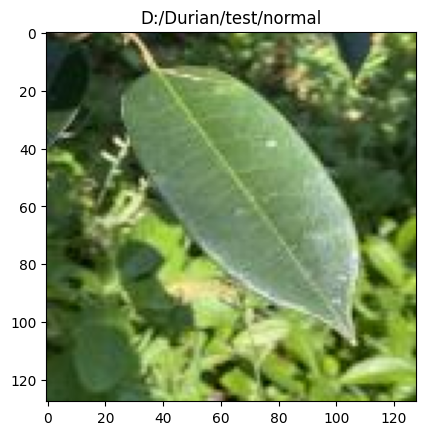

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease010_jpg.rf.195f7d95e10b7e4a69cdbfd29e90c66b.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.06921919 0.2730073  0.00231369 0.6299012  0.02555871]]
predict : normal


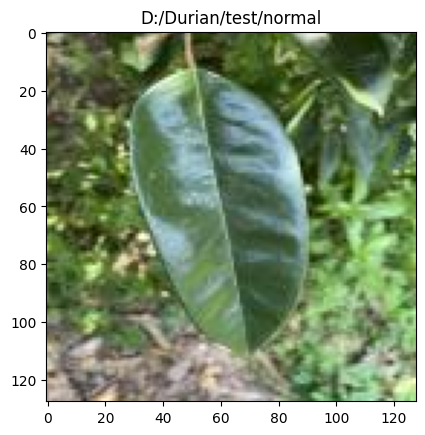

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease016_jpg.rf.a2ebc9112ddf8c503f197b9b5a206c67.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[5.5225804e-02 6.7553848e-01 4.0841303e-05 2.5982445e-01 9.3704518e-03]]
predict : Anthracnose


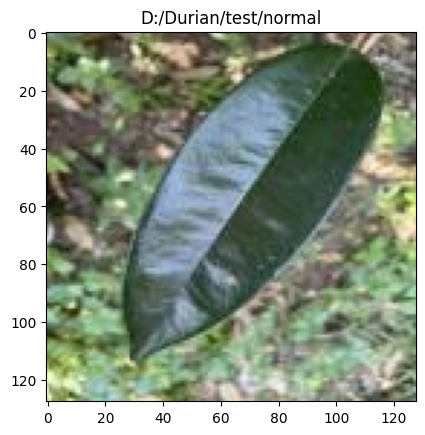

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease017_jpg.rf.1e8984801dfb51c27c75757e069c4e02.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.04559692 0.00407366 0.02289506 0.9104185  0.01701588]]
predict : normal


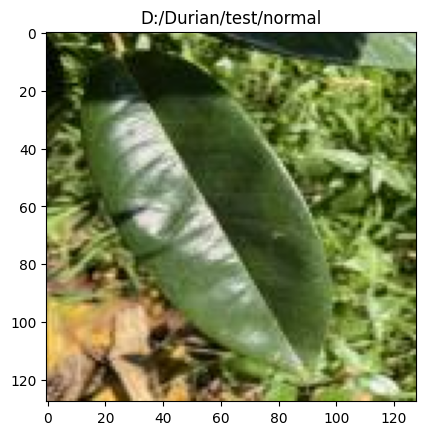

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease019_jpg.rf.14fc4a9c43ca83940e244371e0bb23b0.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.6491155  0.02272844 0.26710492 0.04610395 0.01494718]]
predict : agal_spot


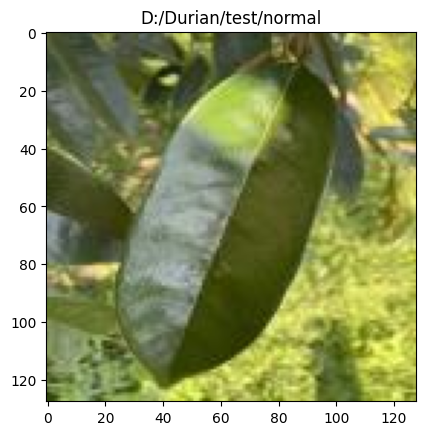

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease020_jpg.rf.1654c815d068ccf47f89b255a29163c4.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.04091642 0.40414056 0.00360896 0.5230485  0.02828562]]
predict : normal


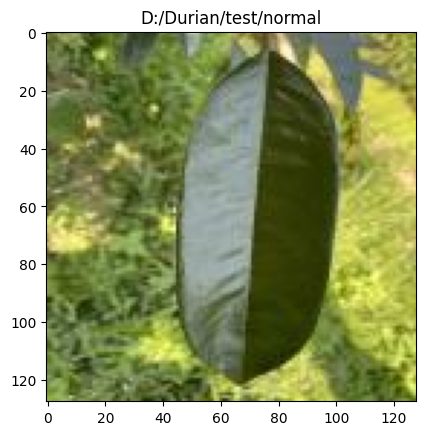

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease022_jpg.rf.66f09d4933c1299cfc312e27636c6c94.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.2679880e-03 9.9098623e-01 2.8563380e-05 6.2836832e-03 1.4335584e-03]]
predict : Anthracnose


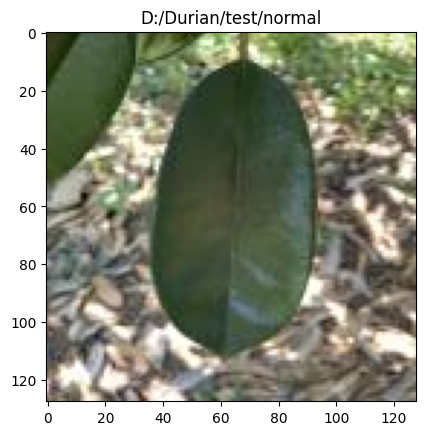

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease023_jpg.rf.93e42ae720c0ac5fc42241ca4e02a2f4.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.13541971 0.14801474 0.01398825 0.6675161  0.03506118]]
predict : normal


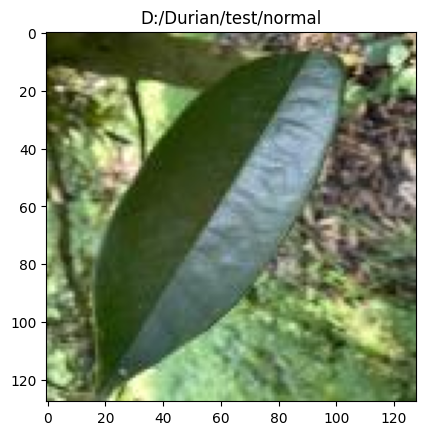

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease025_jpg.rf.574fcd3a600cc6318ab709ba1a9ef27d.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.3285191e-03 4.2748243e-01 2.6814974e-05 5.6438136e-01 6.7808996e-03]]
predict : normal


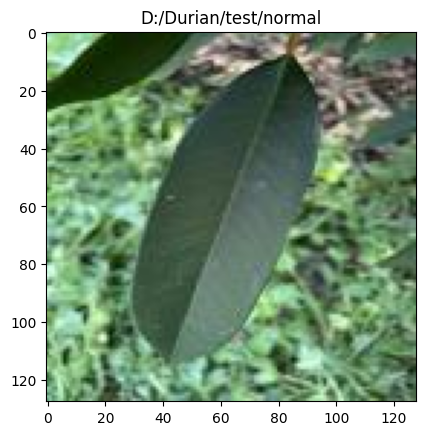

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease029_jpg.rf.a5452ec81bd4c1ccf8241c8acab77f69.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.775825   0.12148558 0.01068356 0.0758715  0.01613429]]
predict : agal_spot


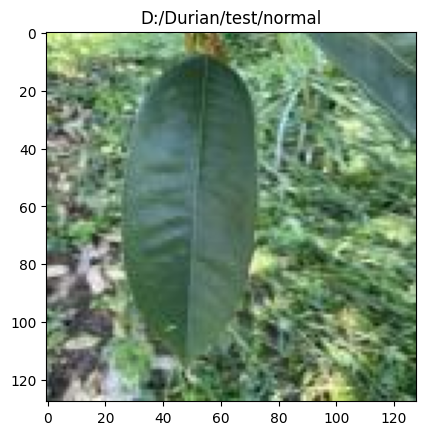

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease031_jpg.rf.3b86194edb1d72c4076c15eceb16165a.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0825391  0.04869961 0.00139207 0.8498612  0.01750789]]
predict : normal


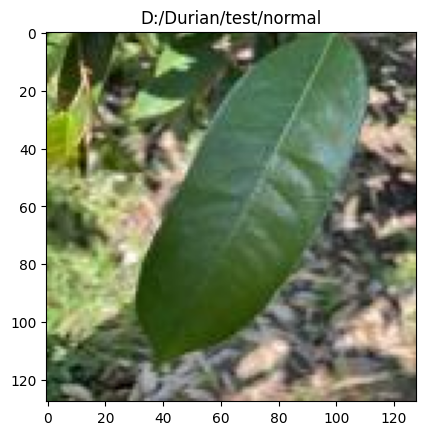

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease034_jpg.rf.ef722d979be4336332561666114e73c6.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.6598311e-03 1.2291322e-01 7.5586802e-05 8.6765558e-01 7.6956754e-03]]
predict : normal


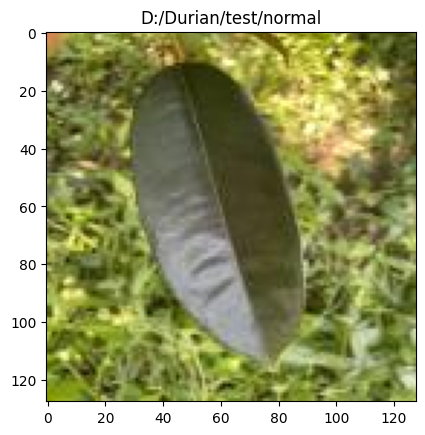

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease035_jpg.rf.b198a3e35bebd04274191bde830406ea.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01368776 0.7722512  0.1766855  0.01706826 0.02030726]]
predict : Anthracnose


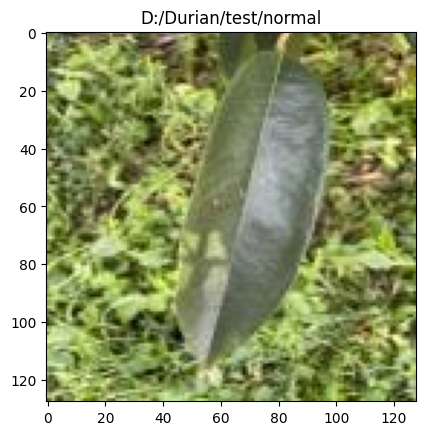

1/1 [==============================] - 0s 17ms/step
file : D:/Durian/test/normal\NoDisease039_jpg.rf.5b8b406cf9a8d6935a1c89c1ebd2ebdc.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.4863458e-03 1.0991610e-03 5.8888600e-05 9.9405956e-01 2.2960622e-03]]
predict : normal


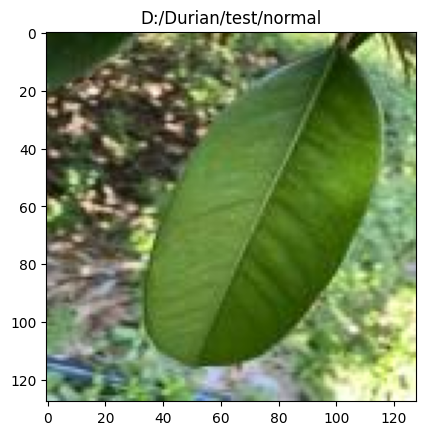

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease041_jpg.rf.2709c4d088e693b5d48174bd43521d07.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.5288201e-02 7.9312086e-01 9.5074160e-05 1.8304130e-01 8.4545519e-03]]
predict : Anthracnose


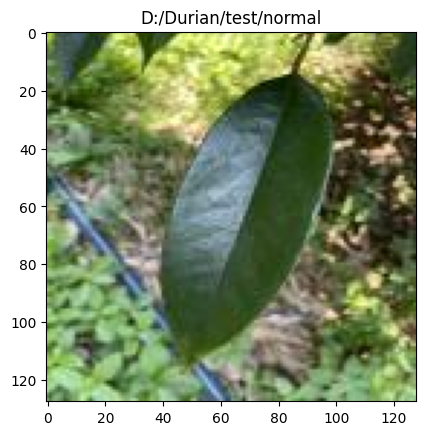

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease050_jpg.rf.e7582062325ea3ccb0095308ff95570f.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.05710064 0.7013769  0.00416007 0.21261157 0.02475083]]
predict : Anthracnose


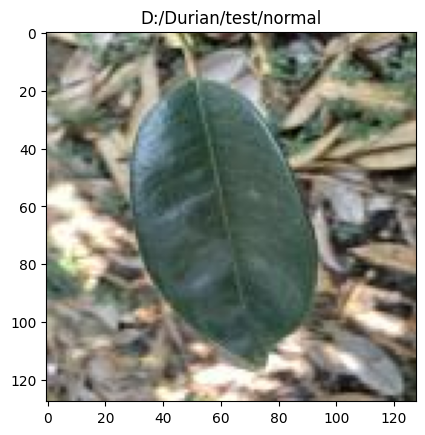

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease057_jpg.rf.0225c0d23752fd446a803f25420914ad.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.09879673 0.03513546 0.42080146 0.39930725 0.04595915]]
predict : left_blinght


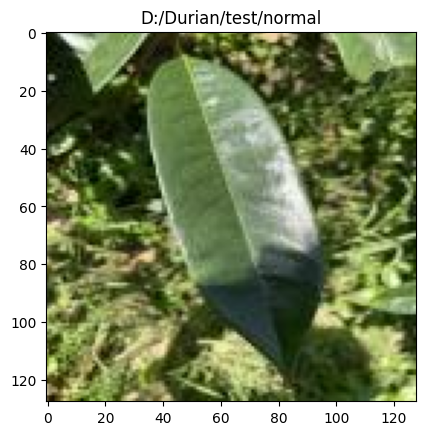

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/normal\NoDisease058_jpg.rf.a60a0d8b6f2e43d3e8c867bd13273647.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.8577808  0.02142291 0.10295249 0.01008095 0.00776283]]
predict : agal_spot


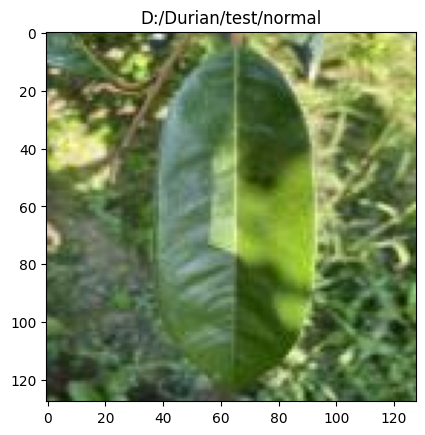

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease060_jpg.rf.26b28a40d030b55ac2b5e6c4a8c518df.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.16833591 0.59447676 0.00361614 0.20979552 0.02377567]]
predict : Anthracnose


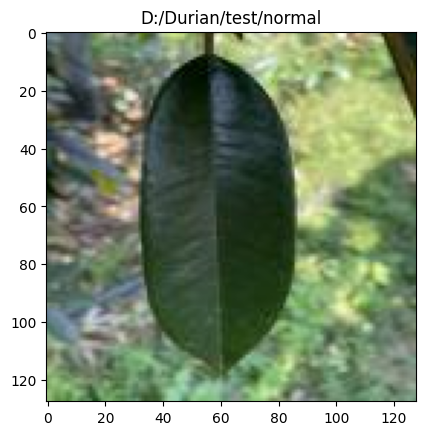

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease061_jpg.rf.97403c4df65e0865077d27a11898c0ae.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.13521603 0.07861178 0.07515337 0.6678795  0.04313929]]
predict : normal


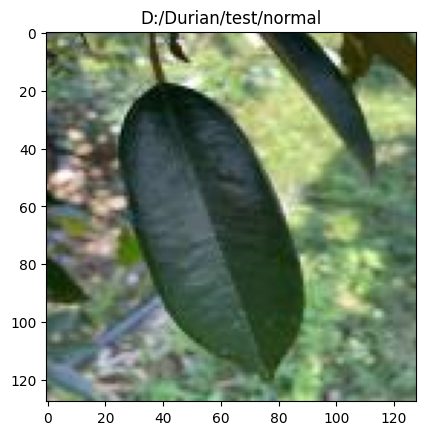

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease067_jpg.rf.7f576d3a689656e7173f13015fcb7167.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.0824111e-03 3.1581163e-02 4.5065692e-05 9.6004277e-01 5.2486458e-03]]
predict : normal


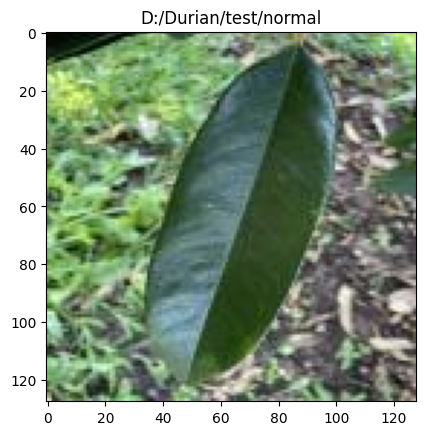

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease072_jpg.rf.16868e88fb7717f72841305087d68f1e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.09803467 0.29842302 0.0049569  0.56764144 0.03094399]]
predict : normal


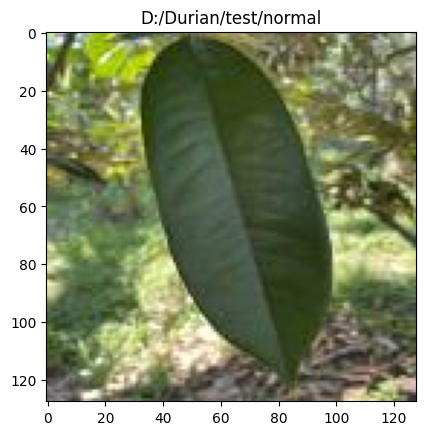

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease074_jpg.rf.6449c71315536d94d97e95054f3076f1.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.5612882  0.00232928 0.00295952 0.42579952 0.00762346]]
predict : agal_spot


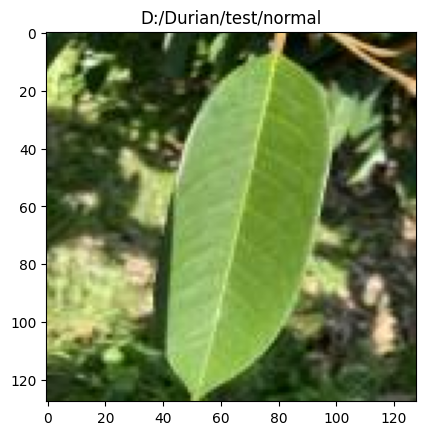

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease076_jpg.rf.d50b02ae995b9ef026bb43e5d6dbd995.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.66653496 0.09253645 0.00433291 0.21844186 0.0181538 ]]
predict : agal_spot


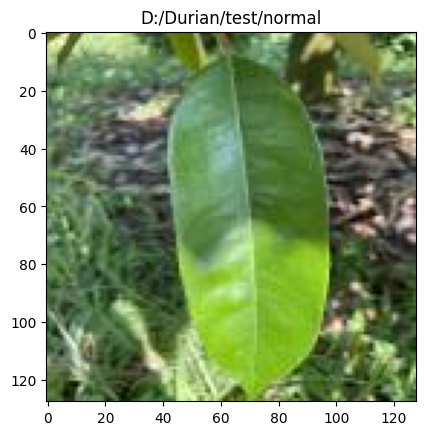

1/1 [==============================] - 0s 22ms/step
file : D:/Durian/test/normal\NoDisease080_jpg.rf.076ef8e326aad6c3d8dfa1ecd9b3a81e.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[8.0650844e-02 1.5070127e-02 3.8713326e-05 8.9847630e-01 5.7640257e-03]]
predict : normal


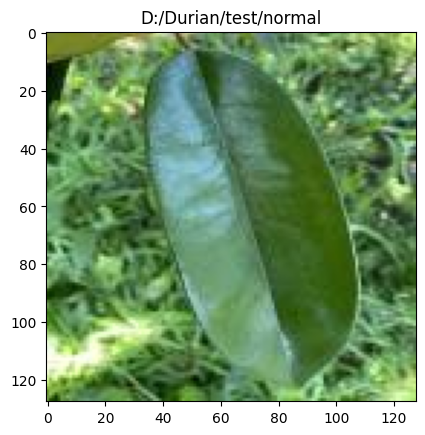

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease081_jpg.rf.d92e1399adf6864a10e7b98bbefac1b3.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.1613128e-02 4.4751513e-01 3.2476793e-04 5.2640063e-01 1.4146326e-02]]
predict : normal


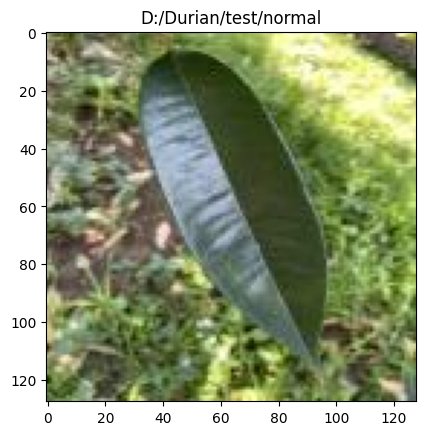

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease082_jpg.rf.4c9ec57aba8a7012ae41e140c238237a.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[5.2730691e-02 3.7717599e-01 5.3576474e-05 5.5843335e-01 1.1606329e-02]]
predict : normal


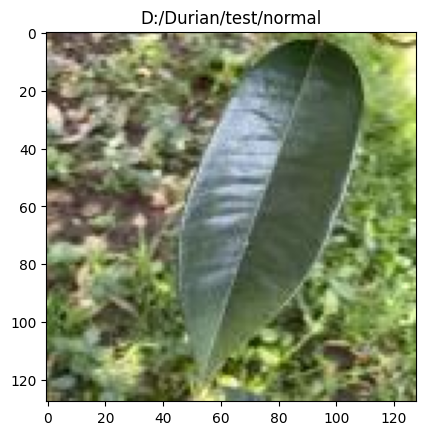

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease086_jpg.rf.699530db173ad57d17b40f118c78c649.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.00537682 0.65586853 0.00279668 0.31594104 0.02001695]]
predict : Anthracnose


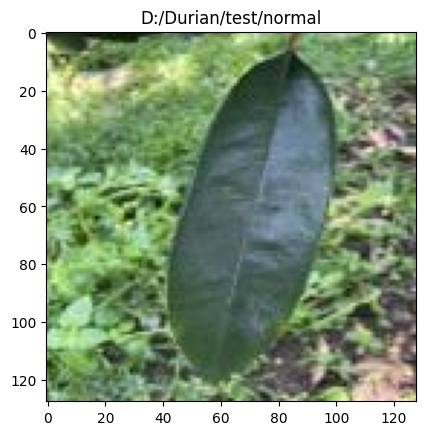

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease088_jpg.rf.117122dfaa6c82b7840fa2babbf7a9bf.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.0140509  0.4491686  0.00364978 0.5061138  0.02701689]]
predict : normal


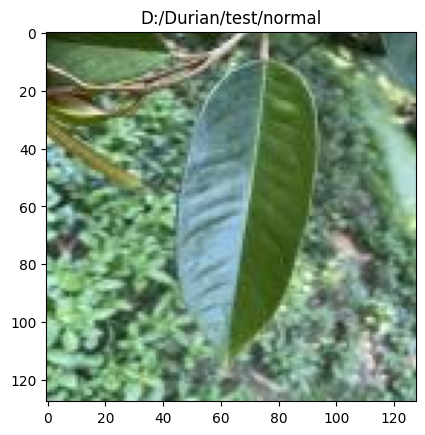

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease090_jpg.rf.b757cae25e9d7abe7396cc576c8888cb.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[4.6898730e-02 3.1620279e-02 1.8960344e-06 9.1797453e-01 3.5046684e-03]]
predict : normal


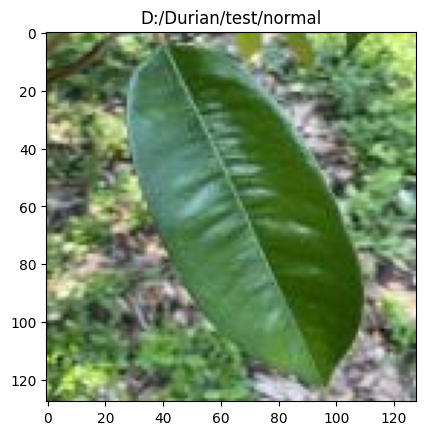

1/1 [==============================] - 0s 23ms/step
file : D:/Durian/test/normal\NoDisease091_jpg.rf.21759aea47647643bb5f6d28ce6a32db.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.4620894e-02 2.5981116e-01 1.6600543e-06 7.2096175e-01 4.6044923e-03]]
predict : normal


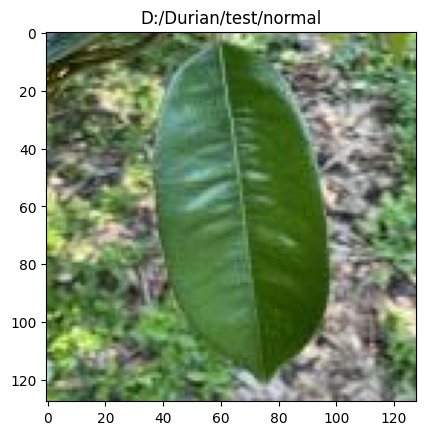

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease095_jpg.rf.42fe98757f23d56c04047d6ea0c4f464.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[3.4888078e-02 2.8190805e-02 6.5918948e-04 9.2388666e-01 1.2375307e-02]]
predict : normal


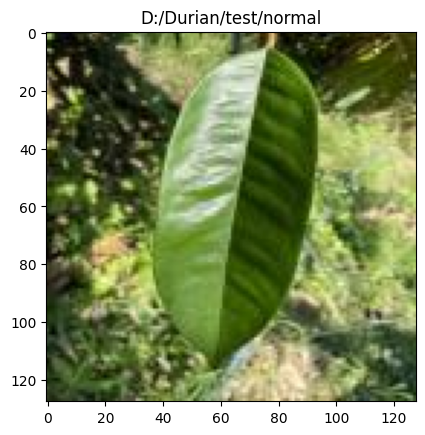

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/normal\NoDisease098_jpg.rf.341b46968bd90f930b1fcddd1d8b02e1.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.07963256 0.4170234  0.00061469 0.48315948 0.01956986]]
predict : normal


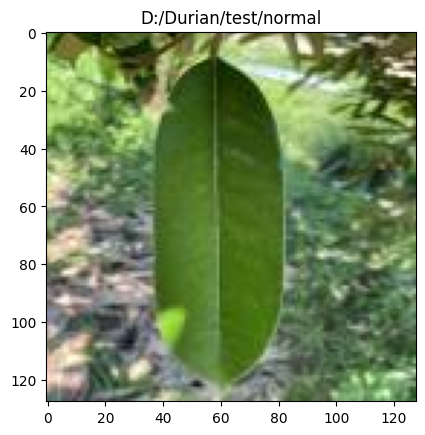

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/normal\NoDisease101_jpg.rf.a21e73d7a2b97f6891a3118d45ad43eb.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[2.1751495e-03 1.7000206e-02 1.9827261e-04 9.7434694e-01 6.2793447e-03]]
predict : normal


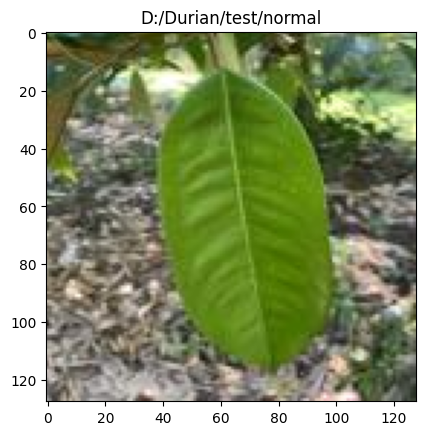

1/1 [==============================] - 0s 21ms/step
file : D:/Durian/test/normal\NoDisease103_jpg.rf.38d719b84395cb156433aef7821ac8dd.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[6.5264362e-03 1.1562726e-03 4.5382811e-05 9.8980558e-01 2.4663408e-03]]
predict : normal


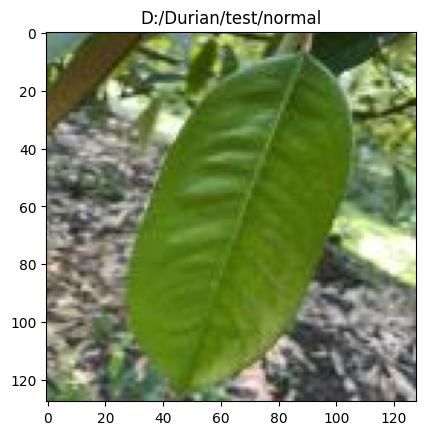

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/normal\NoDisease104_jpg.rf.5b75feb964990e379b8b9e7ede489ef3.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[1.3193874e-01 4.4493411e-02 7.7241840e-04 8.0785763e-01 1.4937780e-02]]
predict : normal


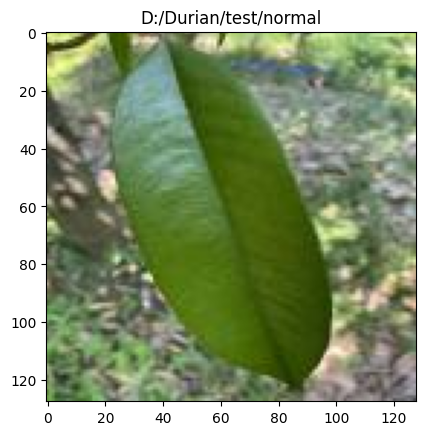

1/1 [==============================] - 0s 19ms/step
file : D:/Durian/test/sooty_mold\3A4C2220-EA7D-4148-82C1-D8BD5451CD79.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[9.6071136e-01 1.8075978e-02 4.7704380e-05 1.9450022e-02 1.7148677e-03]]
predict : agal_spot


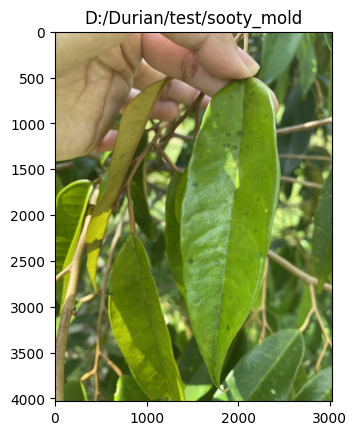

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/sooty_mold\63B84EEA-C2D4-42B3-94EB-2B7D63626B27.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.3951383  0.18061188 0.30902603 0.07735935 0.03786445]]
predict : agal_spot


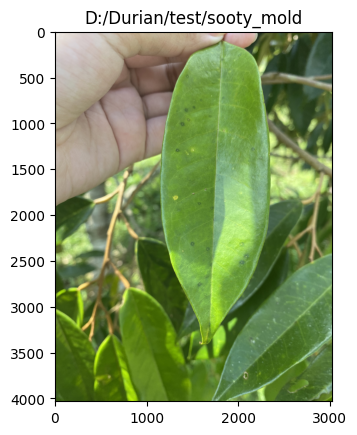

1/1 [==============================] - 0s 20ms/step
file : D:/Durian/test/sooty_mold\86EE8DB3-21CB-4892-AA9E-B4A15A1195E3.jpeg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.01438093 0.33991396 0.58050185 0.03868558 0.02651766]]
predict : left_blinght


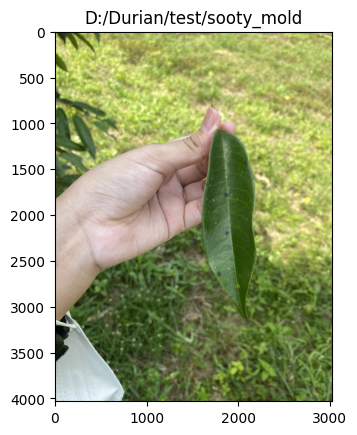

1/1 [==============================] - 0s 18ms/step
file : D:/Durian/test/sooty_mold\IMG_4656.JPG
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[9.2478305e-01 6.9232121e-02 6.3512713e-04 3.2216820e-03 2.1280213e-03]]
predict : agal_spot


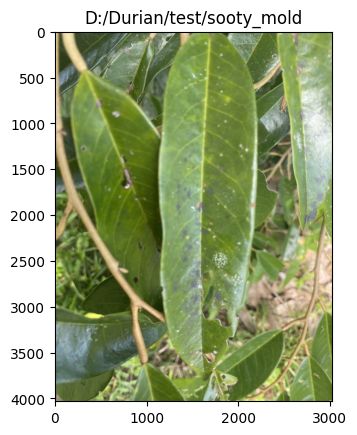

In [31]:
testpath = 'D:/Durian/test/'
testImg = [testpath+f for f in listdir(testpath)]
rimg = []
for imagePath in (testImg):
    for i,item in enumerate(listdir(imagePath)):
        file = join(imagePath, item)
        imgori = cv2.imread(file)
        imgori = cv2.cvtColor(imgori , cv2.COLOR_BGR2RGB)
        img = cv2.resize(imgori ,(width,width))
        rimg = np.array(img)
        rimg = rimg.astype('float32')
        rimg /= 255
        rimg = np.reshape(rimg ,(1,128,128,3))
        predict = model.predict(rimg)
        label = ['agal_spot','Anthracnose','left_blinght','normal','sooty_mold']
        result = label[np.argmax(predict)]
        plt.title(imagePath)
        # cv2.putText(imgori, str(result), (25,25), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2 )
        print('file : {}'.format(file))
        print(label)
        print('predict_table : {}'.format(predict))
        print('predict : {}'.format(result))
        plt.imshow(imgori)
        plt.show()


In [19]:
label_replace = {
  "Anthracnose" : 0 ,
  "black_mold" : 1 ,
  "mold" : 2,
  "rusty" : 3
}

label_unreplace = {
   '0' : "Anthracnose" ,
   '1': "black_mold" ,
   '2': "mold",
   '3': "rusty"
}

In [17]:
model.save("model3.h5")



---



---


This for try out your image

In [13]:
testpath = 'test/'
testImg = [testpath+f for f in listdir(testpath) if listdir(join(testpath, f))]
rimg = []
for imagePath in (testImg):
    for item in (os.listdir(imagePath)):
        file = os.path.join(imagePath, item)
        if item.split('.')[0] != "":
             M  
          img = cv2.imread(file , cv2.COLOR_BGR2RGB)
          ori = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
          img = cv2.resize(img ,(width,width))
          rimg = np.array(img)
          rimg = rimg.astype('float32')
          rimg /= 255
          rimg = np.reshape(rimg ,(1,128,128,3))
          predict = model.predict(rimg)
          label = ['Aedes','Culex']
          result = label[np.argmax(predict)]
          print(predict)
          print('real:'+str(item))
          print('predict:'+str(result))
          plt.imshow(ori)
          plt.show()



NameError: name 'os' is not defined

In [14]:
def create_model():
  model = tf.keras.Sequential([
    tf.keras.layers.Dense(512, activation='relu', input_shape=(784,)),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(10)
  ])

In [15]:
model = create_model()

In [31]:
model.load_weights('model3.h5')

1/1 [==============================] - 0s 17ms/step
file : test2.jpg
['agal_spot', 'Anthracnose', 'left_blinght', 'normal', 'sooty_mold']
predict_table : [[0.75274813 0.07521999 0.00918348 0.14140515 0.02144324]]
predict : agal_spot


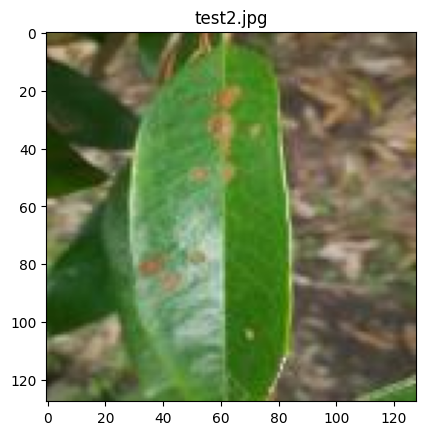

In [34]:
        path_img = 'test2.jpg'
        file = path_img
        imgori = cv2.imread(file)
        imgori = cv2.cvtColor(imgori , cv2.COLOR_BGR2RGB)
        img = cv2.resize(imgori ,(width,width))
        rimg = np.array(img)
        rimg = rimg.astype('float32')
        rimg /= 255
        rimg = np.reshape(rimg ,(1,128,128,3))
        predict = model.predict(rimg)
        label = ['agal_spot','Anthracnose','left_blinght','normal','sooty_mold']
        result = label[np.argmax(predict)]
        plt.title(path_img)
        # cv2.putText(imgori, str(result), (25,25), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2 )
        print('file : {}'.format(file))
        print(label)
        print('predict_table : {}'.format(predict))
        print('predict : {}'.format(result))
        plt.imshow(imgori)
        plt.show()
